<a href="https://colab.research.google.com/github/abualia4/1807.03078/blob/master/DL4PuDe.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

## Mounting Google Drive

In [1]:
from google.colab import drive
drive.mount('/content/drive')


Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


# Importing Necessary Libraries

In [2]:
import sys
home_path='/content/drive/My Drive/Colab Notebooks/RealTime/'
sys.path.insert(0,home_path)
from IPython.display import Image
from IPython.display import Image, display
import cv2
from google.colab import output
from google.colab.patches import cv2_imshow
from matplotlib import pyplot as plt
from IPython.display import display
import csv
import time
from PIL import Image
import os
sys.path.append('/content/drive/My Drive/Colab Notebooks/RealTime/RAFT/core')
import matplotlib.pyplot as plt
from argparse import ArgumentParser
from collections import OrderedDict
import cv2
import numpy as np
import torch
np.set_printoptions(threshold=sys.maxsize)
from raft import RAFT
from utils import flow_viz
from matplotlib import pyplot as plt
from tensorflow.keras.models import Sequential
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from sklearn.metrics import classification_report, confusion_matrix
import numpy as np
import warnings
warnings.filterwarnings('ignore')
from tensorflow.keras.models import load_model
import tensorflow as tf
import pandas as pd
from tensorflow.keras.preprocessing.image import ImageDataGenerator, load_img, img_to_array
from keras.preprocessing import image
from os import listdir
from os.path import isfile, join
import seaborn as sns 
from tensorflow.keras.models import load_model


# Loading a CNN-based classifier

In [3]:
#Input image size
img_rows, img_cols = 224,224
#Path of the loaded model
CNN_path=home_path+"models/EfficientNetB0-MIM-entrance2-png-224-224.h5"
CNN_model= load_model(CNN_path)
CNN_model.load_weights(CNN_path)


# Image Classification based on the Model

In [4]:
def classify(img):
    img = img[...,::-1]
    im_pil = Image.fromarray(img)
    im_resized = im_pil.resize((img_rows, img_cols))
    img_array = image.img_to_array(im_resized)
    image_array_expanded = np.expand_dims(img_array, axis = 0)
     
    group=CNN_model.predict(image_array_expanded )
    if(group>=0.5):
        return 1
    else:
        return 0  

# Determining the Coordinates of the Patches

In [5]:
def patchBorder(rows, cols, left_top_x,left_top_y,right_bottom_x, right_bottom_y ):
        global x1
        x1=[]
        global x2
        x2=[]
        global y1
        y1=[]
        global y2
        y2=[]
        print(rows, cols, left_top_x,left_top_y,right_bottom_x, right_bottom_y)
        width=right_bottom_x-left_top_x
        height=right_bottom_y-left_top_y
        for i in range(rows):
            for j in range(cols):
                 
                patch_width=int(width/cols)
                patch_height=int(height/rows)
            
                left_x=left_top_x+patch_width*j
                right_x=left_top_x+patch_width*(j+1)
                left_y=left_top_y+patch_height*i
                right_y=left_top_y+patch_height*(i+1)
                
                x1.append(left_x)
                x2.append(right_x)
                y1.append(left_y)
                y2.append(right_y)
        if(x1[0]>x2[0]):
            return(x2,y1,x1,y2)
        else:
            return(x1,y1,x2,y2)   
        

# Visualizing the Optical Flow Vectors and Annotating the Patches.

In [12]:
def vizualize_flow(img, flo, save, counter):
    
    counter=counter-49+10000
   
    img = img[0].permute(1, 2, 0).cpu().numpy()
    flo = flo[0].permute(1, 2, 0).cpu().numpy()
    aMIM=time.time()
    flo = flow_viz.flow_to_image(flo)
    bMIM=time.time()
    print("Time for MIM:",(bMIM-aMIM))
    flo = cv2.cvtColor(flo, cv2.COLOR_RGB2BGR)
    
    
    cv2.imwrite(home_path+"outputs/MIMFlow-37/"+str(counter)+".png", flo)

    img = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
    
    for patch_no in range (0,len(x1)):
      
       group=0
       patch=flo[y1[patch_no]:y2[patch_no],x1[patch_no]:x2[patch_no]]
       alabel=time.time()
       if(classify(patch)==1): 
           cv2.rectangle(img, (int(x1[patch_no])+2,int(y1[patch_no])+2), (int(x2[patch_no]+2),int(y2[patch_no])-2), (255,255,255),2)
           cv2.putText(img, str(patch_no), (x1[patch_no],y1[patch_no]), cv2.FONT_HERSHEY_SIMPLEX, 0.5, (255,255,255), 0)
           group=1
      
       blabel=time.time()  
       print("Time for classification and annotataion: ", (blabel-alabel))
    
    ashow=time.time()  
    cv2_imshow(img)
    bshow=time.time()  
    print("Time for show: ", (bshow-ashow))
    return True

# Updating ROI Coordinates to Fit Tensor Size

In [8]:
def new_roi(ratio, roi):
    
    w=roi[2]-roi[0]
    h=roi[3]-roi[1]
    new_w=int(w*ratio)
    new_w=new_w+(24-(new_w%24))
    new_h=int(h*ratio)
    new_h=new_h+(24-(new_h%24))
    
    roi[0]=int(roi[0]*ratio)
    roi[1]=int(roi[1]*ratio)
    roi[2]=roi[0]+new_w
    roi[3]=roi[1]+new_h
   
    return roi

# Frames Extraction and Processing, Optical Flow Vectors Estimation and Visualization

In [9]:
def frame_preprocess(frame, device):
    frame = torch.from_numpy(frame).permute(2, 0, 1).float()
    frame = frame.unsqueeze(0)
    frame = frame.to(device)
    return frame

In [10]:
def inference(args):   
    # get the RAFT model
    model = RAFT(args)
    
    # load pretrained weights
   # pretrained_weights = torch.load(args.model,map_location ='cpu')
    pretrained_weights = torch.load(args.model)
    
    save = args.save
    
    if torch.cuda.is_available():
        device = "cuda"
        # parallel between available GPUs
        model = torch.nn.DataParallel(model)
        # load the pretrained weights into model
        model.load_state_dict(pretrained_weights)
        model.to(device)
   
     
    # change model's mode to evaluation
    model.eval()
    # Parameters

    video_path = args.video
    rows=args.patch[0]
    cols=args.patch[1]
    roi_original=args.roi
    roi_n=new_roi(args.ratio, args.roi)
    a=time.time()
    # capture the video and get the first frame
    cap = cv2.VideoCapture(video_path)
    ret, frame_1 = cap.read()
    
    counter = 0
    #fps = cap.get(cv2.CAP_PROP_FPS)
    frame_width=frame_1.shape[1]
    frame_height=frame_1.shape[0]
    dim = (int(frame_width*args.ratio),int(frame_height*args.ratio))
    frame_1 = cv2.resize(frame_1, dim, interpolation = cv2.INTER_AREA)
   
    frame_1=frame_1[roi_n[1]:roi_n[3],roi_n[0]:roi_n[2]]
    x1,y1,x2,y2=patchBorder(rows, cols, 0,0,int(frame_1.shape[1]), int(frame_1.shape[0]) )
    
    frame_1 = frame_preprocess(frame_1, device)
   
    
    with torch.no_grad():
        while True:
            
            # read the next frame
            ret, frame_2 = cap.read()
           
            if not ret:
                break
            if (counter)%49==0 and counter>0:
              
                # preprocessing
                frame_2 = cv2.resize(frame_2, dim, interpolation = cv2.INTER_AREA)
                
                frame_2=frame_2[roi_n[1]:roi_n[3],roi_n[0]:roi_n[2]]
                frame_2 = frame_preprocess(frame_2, device)
                aflow=time.time()
                flow_low, flow_up = model(frame_1, frame_2, iters=12, test_mode=True)
                bflow=time.time()
                print("Time for optical flow",(bflow-aflow))
                ret = vizualize_flow(frame_1, flow_up, save, counter)
                if not ret:
                    break
                frame_1 = frame_2    
            counter += 1
    b=time.time()
    print("total:",(b-a))

# Start/Main

2 4 0 0 1128 432
Time for optical flow 0.19243168830871582
Time for MIM: 0.07211160659790039
Time for classification and annotataion:  0.05924177169799805
Time for classification and annotataion:  0.05180501937866211
Time for classification and annotataion:  0.0487518310546875
Time for classification and annotataion:  0.04959559440612793
Time for classification and annotataion:  0.04965710639953613
Time for classification and annotataion:  0.0557708740234375
Time for classification and annotataion:  0.05219459533691406
Time for classification and annotataion:  0.059546470642089844


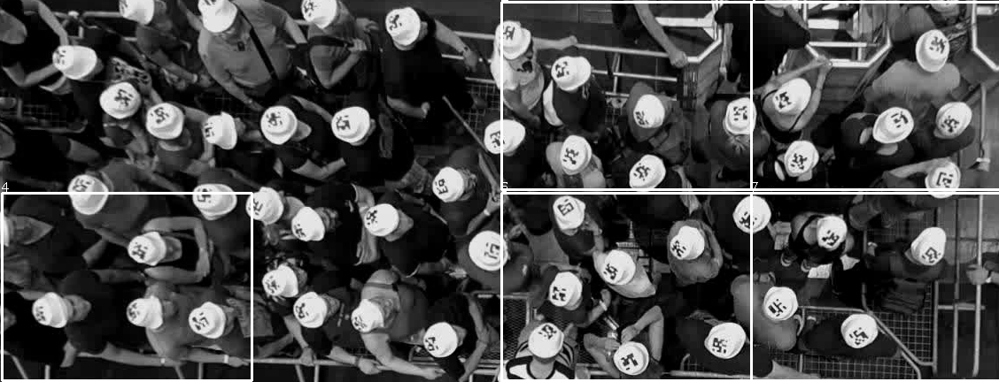

Time for show:  0.08216643333435059
Time for optical flow 0.13740992546081543
Time for MIM: 0.05802011489868164
Time for classification and annotataion:  0.06002402305603027
Time for classification and annotataion:  0.05143022537231445
Time for classification and annotataion:  0.051788330078125
Time for classification and annotataion:  0.05393552780151367
Time for classification and annotataion:  0.0551447868347168
Time for classification and annotataion:  0.04964280128479004
Time for classification and annotataion:  0.058083295822143555
Time for classification and annotataion:  0.05400991439819336


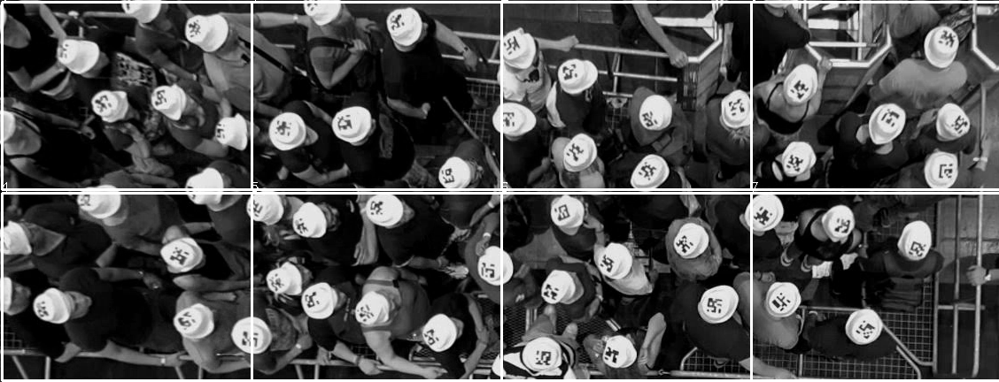

Time for show:  0.06551575660705566
Time for optical flow 0.1366722583770752
Time for MIM: 0.06614065170288086
Time for classification and annotataion:  0.07038545608520508
Time for classification and annotataion:  0.05183219909667969
Time for classification and annotataion:  0.05910062789916992
Time for classification and annotataion:  0.05214214324951172
Time for classification and annotataion:  0.05947446823120117
Time for classification and annotataion:  0.05039620399475098
Time for classification and annotataion:  0.051444292068481445
Time for classification and annotataion:  0.05319046974182129


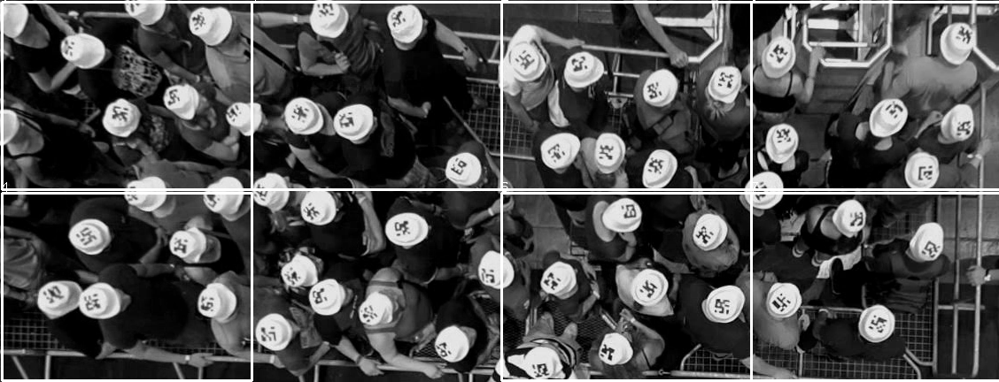

Time for show:  0.07399821281433105
Time for optical flow 0.1377239227294922
Time for MIM: 0.06568503379821777
Time for classification and annotataion:  0.06250977516174316
Time for classification and annotataion:  0.05657839775085449
Time for classification and annotataion:  0.0495760440826416
Time for classification and annotataion:  0.05133247375488281
Time for classification and annotataion:  0.056330204010009766
Time for classification and annotataion:  0.05087876319885254
Time for classification and annotataion:  0.05553436279296875
Time for classification and annotataion:  0.0491793155670166


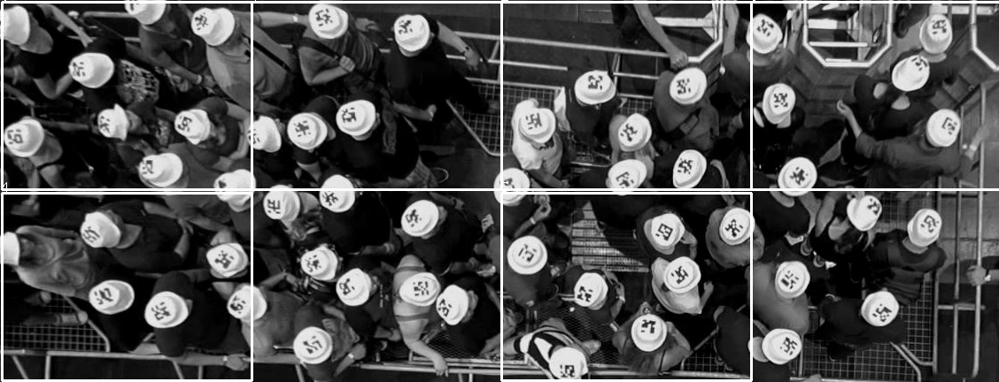

Time for show:  0.0655825138092041
Time for optical flow 0.13643407821655273
Time for MIM: 0.05640387535095215
Time for classification and annotataion:  0.06797337532043457
Time for classification and annotataion:  0.052405595779418945
Time for classification and annotataion:  0.05474662780761719
Time for classification and annotataion:  0.05877828598022461
Time for classification and annotataion:  0.06488895416259766
Time for classification and annotataion:  0.054665327072143555
Time for classification and annotataion:  0.0496368408203125
Time for classification and annotataion:  0.050579071044921875


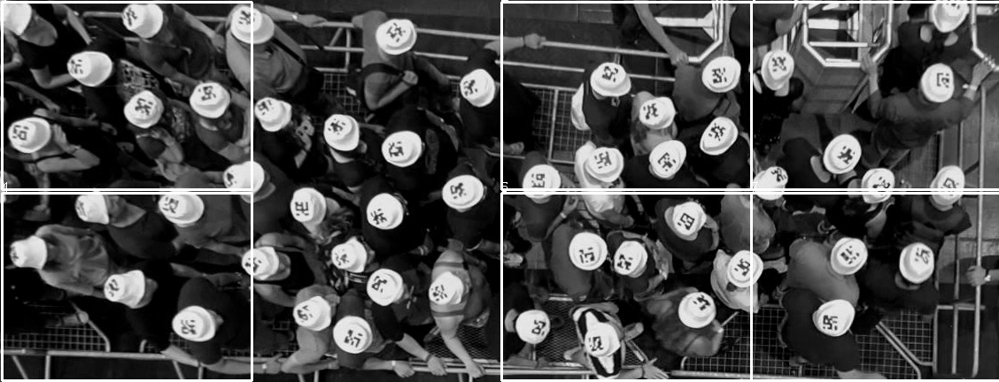

Time for show:  0.07143211364746094
Time for optical flow 0.13641142845153809
Time for MIM: 0.055393218994140625
Time for classification and annotataion:  0.06469917297363281
Time for classification and annotataion:  0.05370640754699707
Time for classification and annotataion:  0.04917192459106445
Time for classification and annotataion:  0.05136680603027344
Time for classification and annotataion:  0.06800389289855957
Time for classification and annotataion:  0.05440688133239746
Time for classification and annotataion:  0.05064225196838379
Time for classification and annotataion:  0.05714893341064453


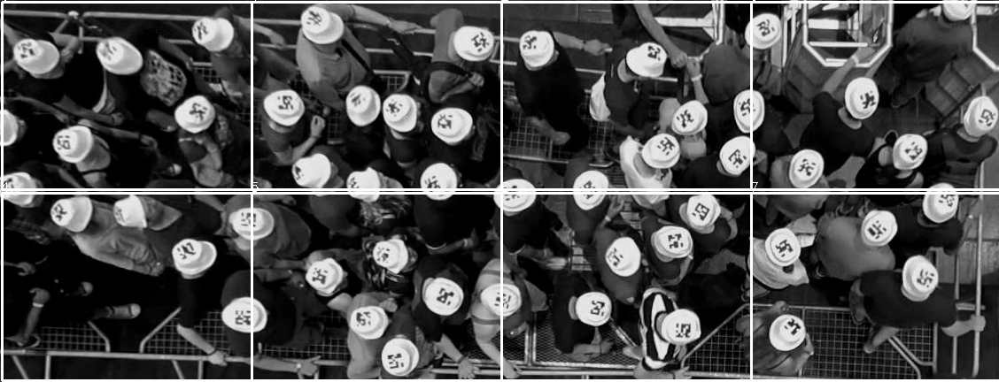

Time for show:  0.0697181224822998
Time for optical flow 0.13634133338928223
Time for MIM: 0.05597972869873047
Time for classification and annotataion:  0.0631256103515625
Time for classification and annotataion:  0.0507960319519043
Time for classification and annotataion:  0.05391812324523926
Time for classification and annotataion:  0.0656282901763916
Time for classification and annotataion:  0.06413555145263672
Time for classification and annotataion:  0.05515408515930176
Time for classification and annotataion:  0.056191205978393555
Time for classification and annotataion:  0.05209922790527344


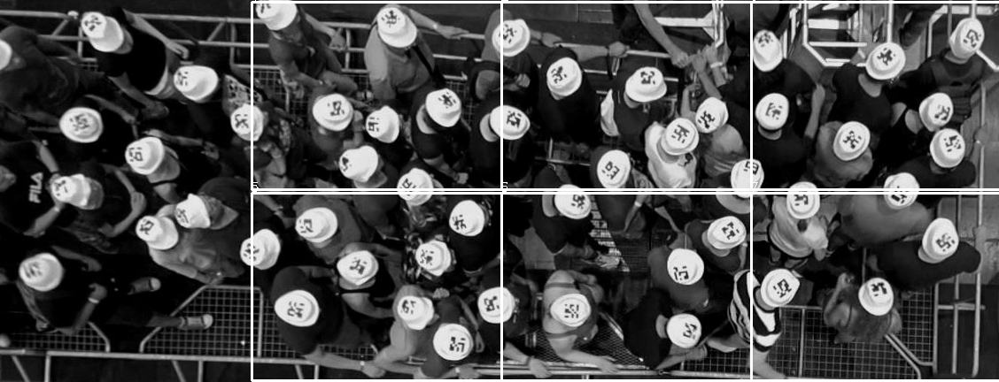

Time for show:  0.06962084770202637
Time for optical flow 0.13703107833862305
Time for MIM: 0.06074404716491699
Time for classification and annotataion:  0.06777405738830566
Time for classification and annotataion:  0.05138707160949707
Time for classification and annotataion:  0.05734086036682129
Time for classification and annotataion:  0.05224132537841797
Time for classification and annotataion:  0.060929059982299805
Time for classification and annotataion:  0.05387592315673828
Time for classification and annotataion:  0.06074070930480957
Time for classification and annotataion:  0.049823760986328125


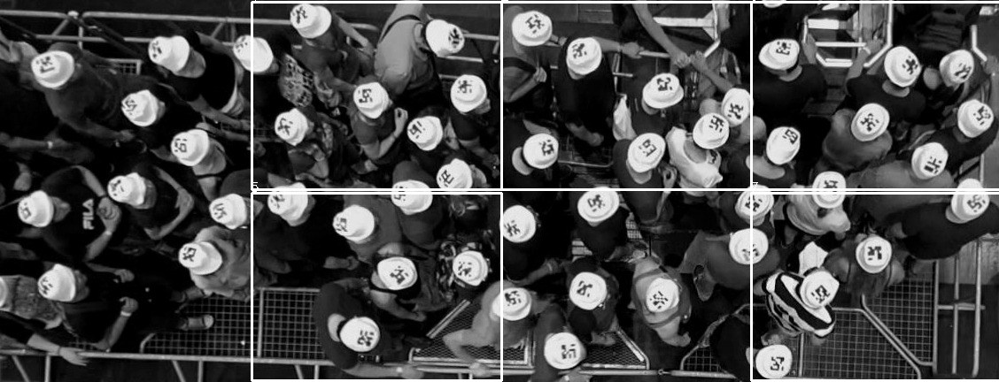

Time for show:  0.07258892059326172
Time for optical flow 0.1373903751373291
Time for MIM: 0.061035871505737305
Time for classification and annotataion:  0.0724802017211914
Time for classification and annotataion:  0.05467033386230469
Time for classification and annotataion:  0.05180978775024414
Time for classification and annotataion:  0.05111432075500488
Time for classification and annotataion:  0.05902743339538574
Time for classification and annotataion:  0.05747866630554199
Time for classification and annotataion:  0.06164669990539551
Time for classification and annotataion:  0.05279397964477539


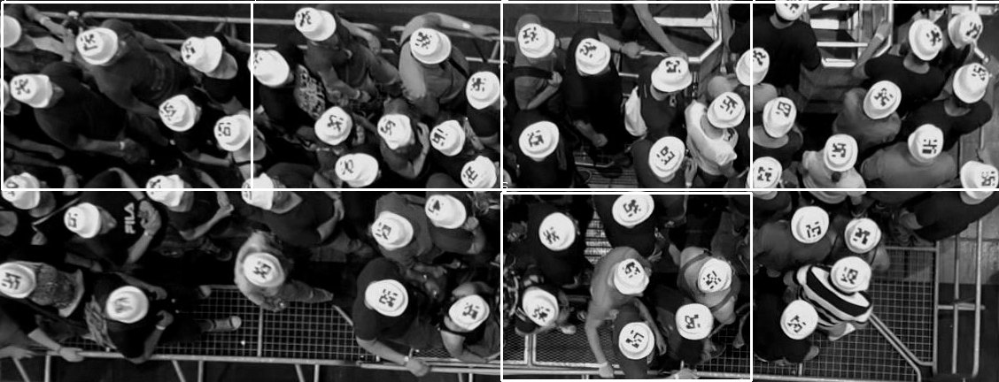

Time for show:  0.07109856605529785
Time for optical flow 0.1378328800201416
Time for MIM: 0.057001352310180664
Time for classification and annotataion:  0.0684812068939209
Time for classification and annotataion:  0.05028676986694336
Time for classification and annotataion:  0.055326223373413086
Time for classification and annotataion:  0.050624847412109375
Time for classification and annotataion:  0.06371545791625977
Time for classification and annotataion:  0.06010770797729492
Time for classification and annotataion:  0.05061960220336914
Time for classification and annotataion:  0.04914593696594238


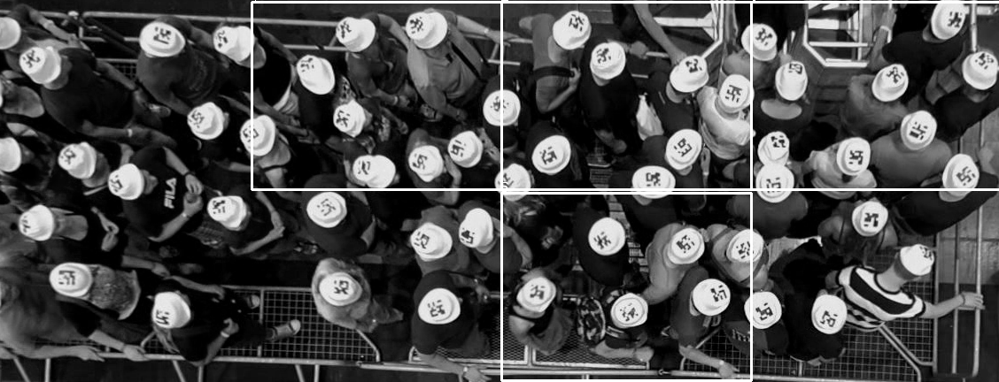

Time for show:  0.08090806007385254
Time for optical flow 0.13672089576721191
Time for MIM: 0.05637526512145996
Time for classification and annotataion:  0.06981468200683594
Time for classification and annotataion:  0.05257821083068848
Time for classification and annotataion:  0.049857139587402344
Time for classification and annotataion:  0.05693674087524414
Time for classification and annotataion:  0.06871819496154785
Time for classification and annotataion:  0.05734872817993164
Time for classification and annotataion:  0.05017900466918945
Time for classification and annotataion:  0.050034284591674805


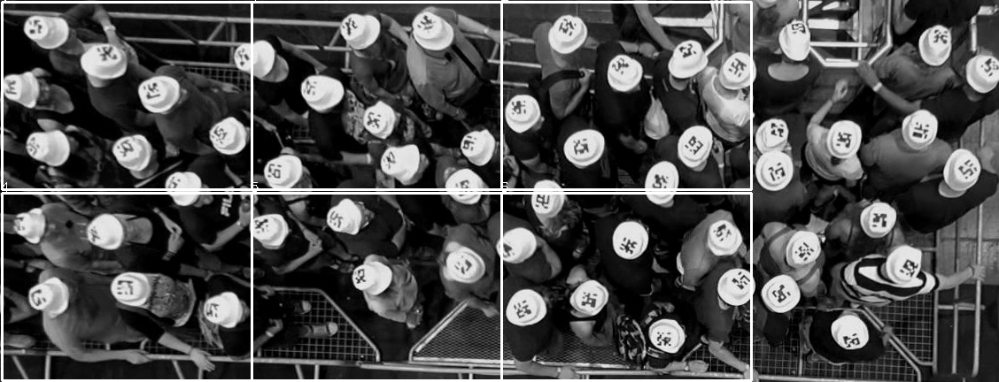

Time for show:  0.07336592674255371
Time for optical flow 0.1375439167022705
Time for MIM: 0.0628054141998291
Time for classification and annotataion:  0.08153629302978516
Time for classification and annotataion:  0.05109357833862305
Time for classification and annotataion:  0.04999065399169922
Time for classification and annotataion:  0.04853940010070801
Time for classification and annotataion:  0.06327605247497559
Time for classification and annotataion:  0.06483793258666992
Time for classification and annotataion:  0.05603837966918945
Time for classification and annotataion:  0.050870656967163086


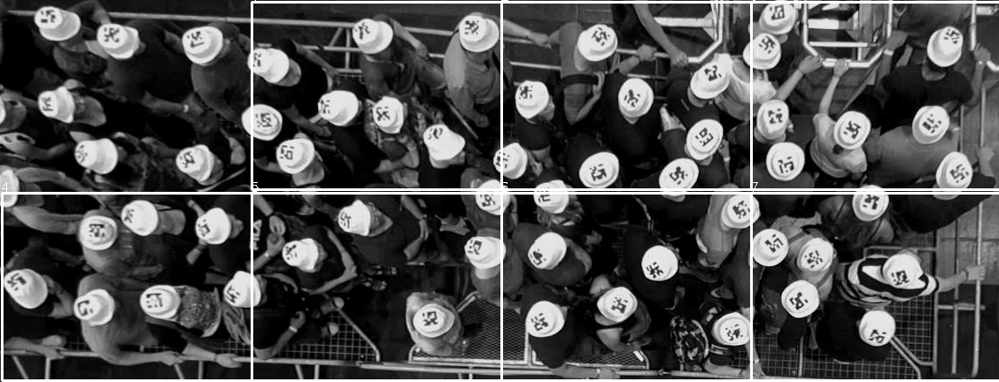

Time for show:  0.07636642456054688
Time for optical flow 0.13757038116455078
Time for MIM: 0.05639815330505371
Time for classification and annotataion:  0.07153773307800293
Time for classification and annotataion:  0.05016827583312988
Time for classification and annotataion:  0.04921841621398926
Time for classification and annotataion:  0.04825901985168457
Time for classification and annotataion:  0.05142569541931152
Time for classification and annotataion:  0.07114791870117188
Time for classification and annotataion:  0.05051136016845703
Time for classification and annotataion:  0.049369096755981445


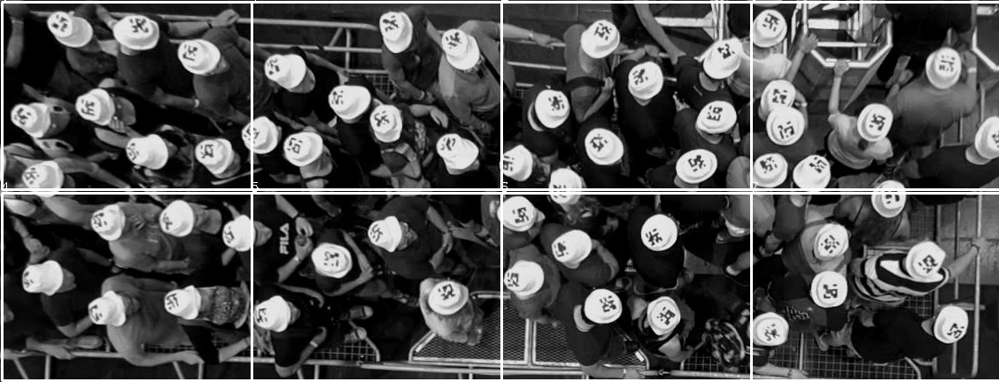

Time for show:  0.07275390625
Time for optical flow 0.13637161254882812
Time for MIM: 0.057340383529663086
Time for classification and annotataion:  0.08105683326721191
Time for classification and annotataion:  0.05191230773925781
Time for classification and annotataion:  0.050327301025390625
Time for classification and annotataion:  0.0501859188079834
Time for classification and annotataion:  0.0813143253326416
Time for classification and annotataion:  0.057359933853149414
Time for classification and annotataion:  0.05743598937988281
Time for classification and annotataion:  0.053133249282836914


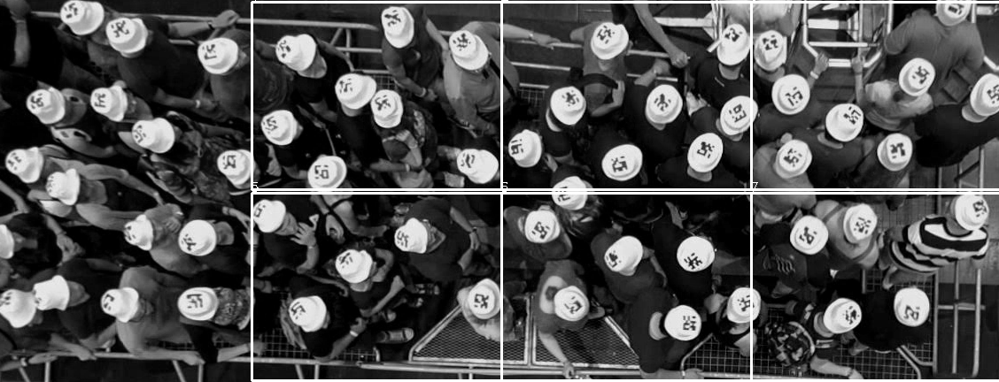

Time for show:  0.07251238822937012
Time for optical flow 0.1365950107574463
Time for MIM: 0.06002974510192871
Time for classification and annotataion:  0.0726466178894043
Time for classification and annotataion:  0.06020522117614746
Time for classification and annotataion:  0.05684661865234375
Time for classification and annotataion:  0.04972553253173828
Time for classification and annotataion:  0.05936264991760254
Time for classification and annotataion:  0.060547590255737305
Time for classification and annotataion:  0.053563833236694336
Time for classification and annotataion:  0.05103707313537598


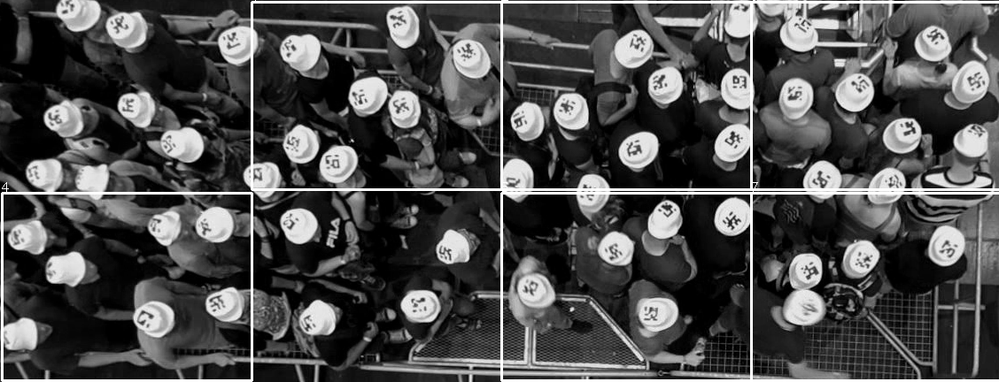

Time for show:  0.07533097267150879
Time for optical flow 0.13777542114257812
Time for MIM: 0.05684971809387207
Time for classification and annotataion:  0.07913732528686523
Time for classification and annotataion:  0.052736520767211914
Time for classification and annotataion:  0.05279731750488281
Time for classification and annotataion:  0.05115175247192383
Time for classification and annotataion:  0.06549620628356934
Time for classification and annotataion:  0.07808995246887207
Time for classification and annotataion:  0.04995894432067871
Time for classification and annotataion:  0.05020451545715332


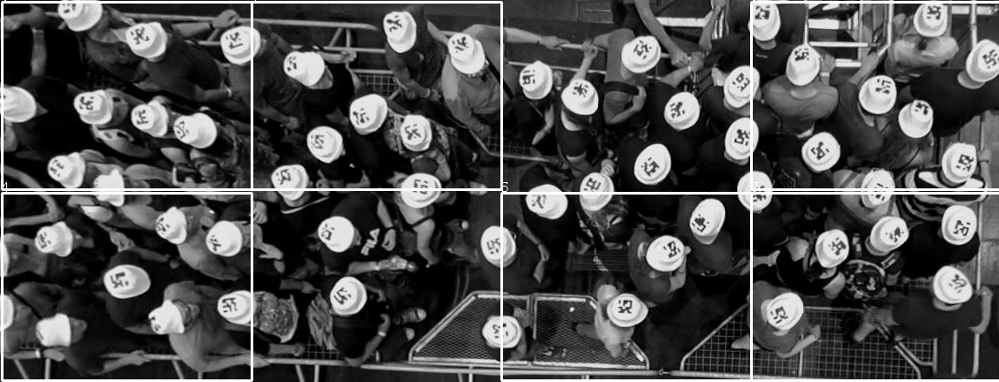

Time for show:  0.0795750617980957
Time for optical flow 0.13794326782226562
Time for MIM: 0.057195425033569336
Time for classification and annotataion:  0.07391977310180664
Time for classification and annotataion:  0.062206268310546875
Time for classification and annotataion:  0.05294036865234375
Time for classification and annotataion:  0.05302143096923828
Time for classification and annotataion:  0.06351351737976074
Time for classification and annotataion:  0.06583905220031738
Time for classification and annotataion:  0.061186790466308594
Time for classification and annotataion:  0.05130290985107422


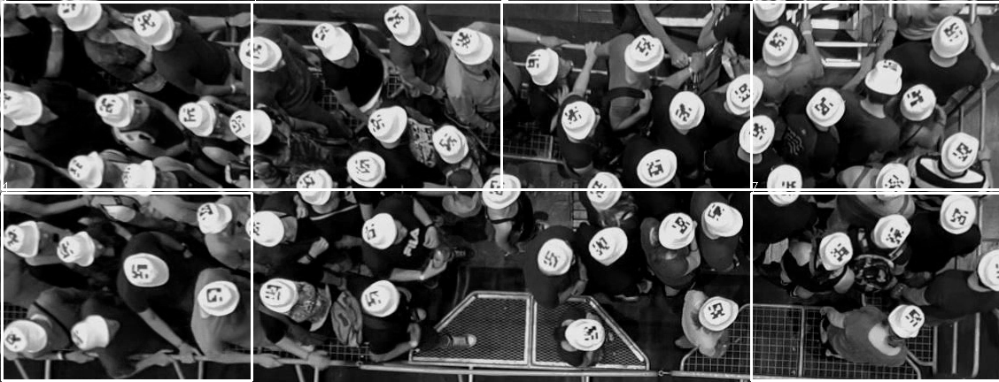

Time for show:  0.08363890647888184
Time for optical flow 0.13638925552368164
Time for MIM: 0.06280112266540527
Time for classification and annotataion:  0.08526945114135742
Time for classification and annotataion:  0.05317354202270508
Time for classification and annotataion:  0.04994916915893555
Time for classification and annotataion:  0.05704331398010254
Time for classification and annotataion:  0.052401065826416016
Time for classification and annotataion:  0.0706644058227539
Time for classification and annotataion:  0.05037212371826172
Time for classification and annotataion:  0.049806833267211914


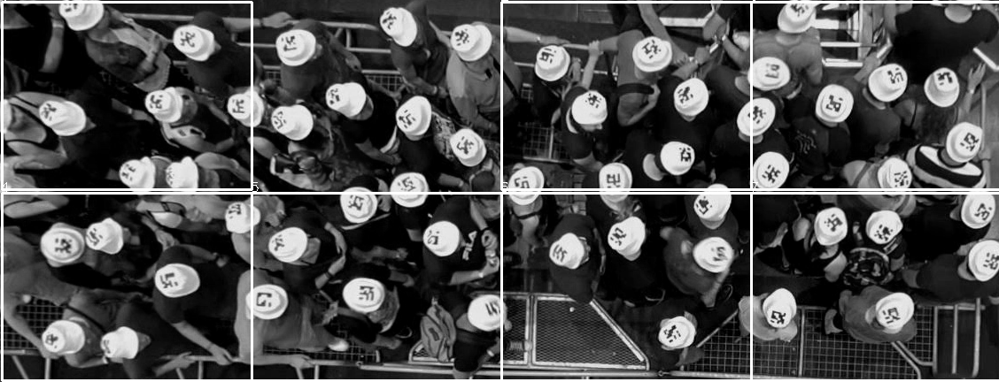

Time for show:  0.08372759819030762
Time for optical flow 0.13845038414001465
Time for MIM: 0.05801820755004883
Time for classification and annotataion:  0.08229184150695801
Time for classification and annotataion:  0.055718421936035156
Time for classification and annotataion:  0.05539703369140625
Time for classification and annotataion:  0.05369925498962402
Time for classification and annotataion:  0.0610353946685791
Time for classification and annotataion:  0.06962227821350098
Time for classification and annotataion:  0.05020403861999512
Time for classification and annotataion:  0.04979300498962402


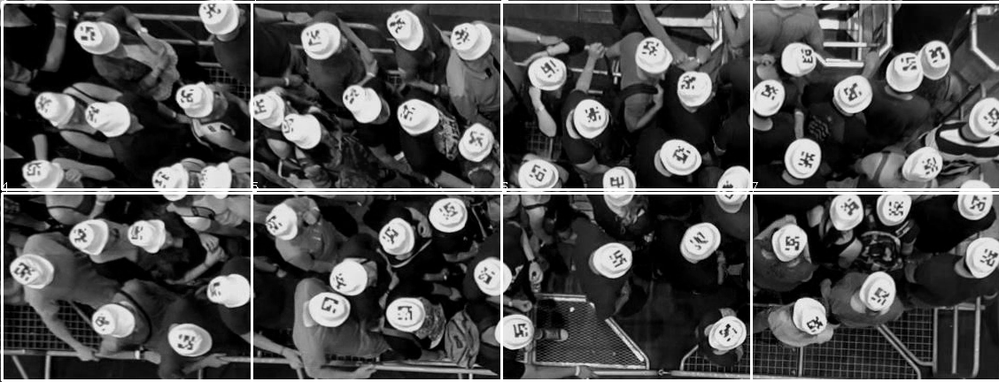

Time for show:  0.08198666572570801
Time for optical flow 0.13699030876159668
Time for MIM: 0.05956673622131348
Time for classification and annotataion:  0.0799405574798584
Time for classification and annotataion:  0.05740761756896973
Time for classification and annotataion:  0.05812954902648926
Time for classification and annotataion:  0.051183462142944336
Time for classification and annotataion:  0.058267831802368164
Time for classification and annotataion:  0.07610177993774414
Time for classification and annotataion:  0.056115150451660156
Time for classification and annotataion:  0.0498659610748291


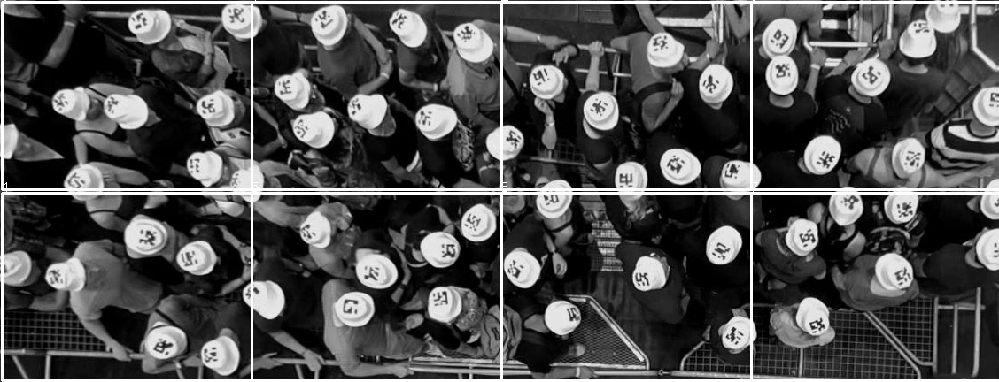

Time for show:  0.07332897186279297
Time for optical flow 0.13724231719970703
Time for MIM: 0.05715060234069824
Time for classification and annotataion:  0.08025717735290527
Time for classification and annotataion:  0.05607891082763672
Time for classification and annotataion:  0.052613258361816406
Time for classification and annotataion:  0.0579833984375
Time for classification and annotataion:  0.07223010063171387
Time for classification and annotataion:  0.06543779373168945
Time for classification and annotataion:  0.051203250885009766
Time for classification and annotataion:  0.0506281852722168


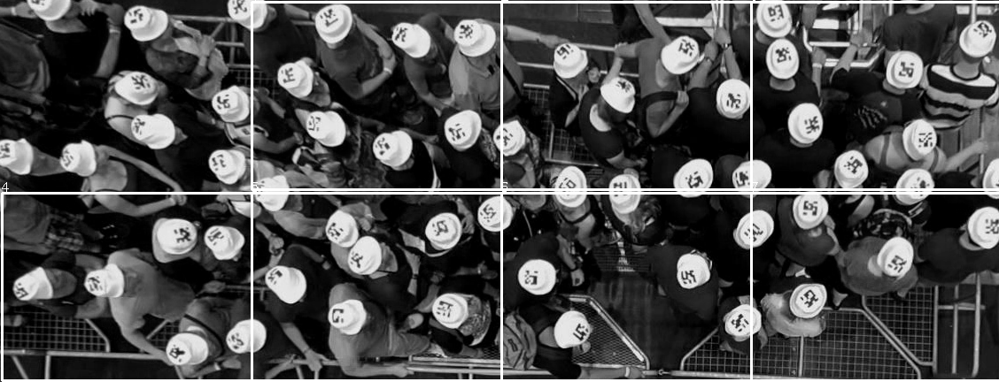

Time for show:  0.07162117958068848
Time for optical flow 0.13798022270202637
Time for MIM: 0.05778384208679199
Time for classification and annotataion:  0.08159637451171875
Time for classification and annotataion:  0.05518031120300293
Time for classification and annotataion:  0.051969051361083984
Time for classification and annotataion:  0.05971670150756836
Time for classification and annotataion:  0.0591585636138916
Time for classification and annotataion:  0.07343530654907227
Time for classification and annotataion:  0.05817461013793945
Time for classification and annotataion:  0.050449371337890625


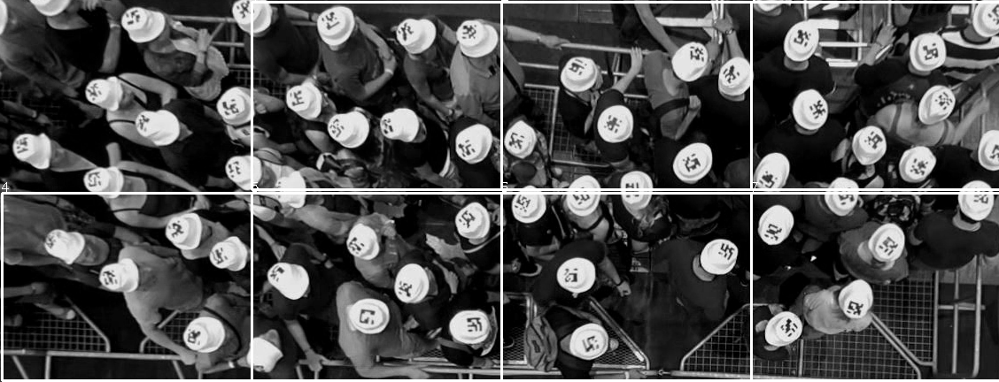

Time for show:  0.07681894302368164
Time for optical flow 0.1376960277557373
Time for MIM: 0.05717873573303223
Time for classification and annotataion:  0.07924413681030273
Time for classification and annotataion:  0.068603515625
Time for classification and annotataion:  0.051918983459472656
Time for classification and annotataion:  0.05092620849609375
Time for classification and annotataion:  0.06557822227478027
Time for classification and annotataion:  0.07963132858276367
Time for classification and annotataion:  0.05247330665588379
Time for classification and annotataion:  0.051711320877075195


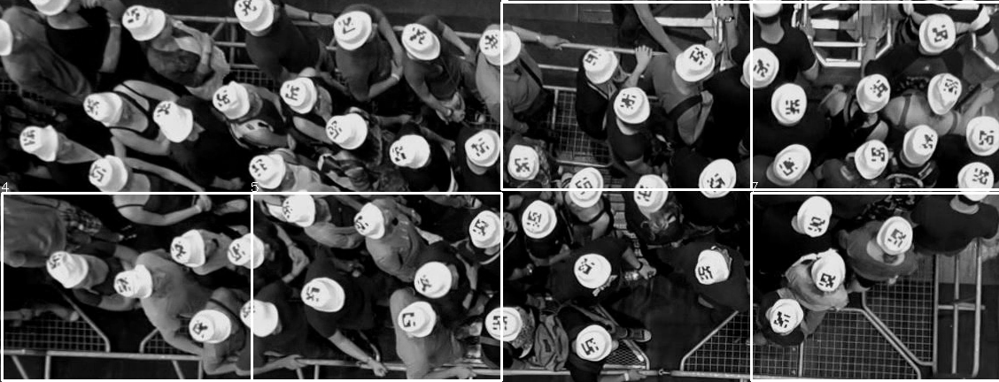

Time for show:  0.08327102661132812
Time for optical flow 0.13777804374694824
Time for MIM: 0.05851173400878906
Time for classification and annotataion:  0.08037185668945312
Time for classification and annotataion:  0.061139822006225586
Time for classification and annotataion:  0.058438777923583984
Time for classification and annotataion:  0.055150508880615234
Time for classification and annotataion:  0.06775069236755371
Time for classification and annotataion:  0.0719451904296875
Time for classification and annotataion:  0.0535578727722168
Time for classification and annotataion:  0.05382275581359863


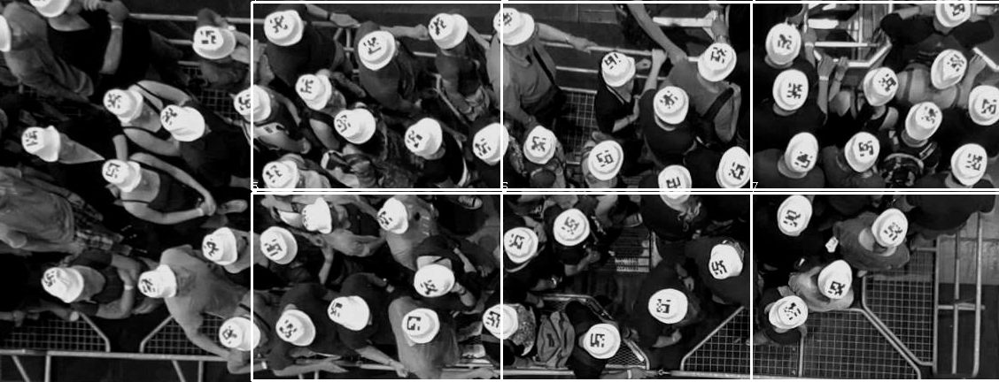

Time for show:  0.0784292221069336
Time for optical flow 0.1386406421661377
Time for MIM: 0.05808615684509277
Time for classification and annotataion:  0.0808255672454834
Time for classification and annotataion:  0.06065225601196289
Time for classification and annotataion:  0.057001590728759766
Time for classification and annotataion:  0.05031633377075195
Time for classification and annotataion:  0.0680243968963623
Time for classification and annotataion:  0.06983780860900879
Time for classification and annotataion:  0.055737972259521484
Time for classification and annotataion:  0.05203557014465332


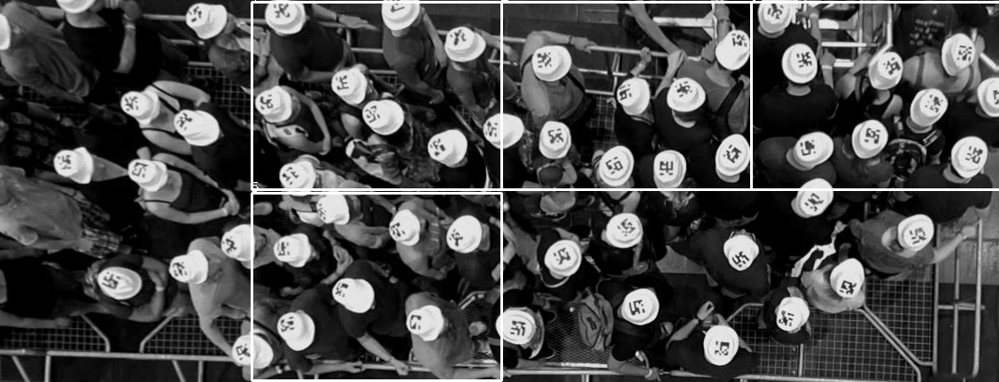

Time for show:  0.07340216636657715
Time for optical flow 0.13914275169372559
Time for MIM: 0.05993986129760742
Time for classification and annotataion:  0.07296061515808105
Time for classification and annotataion:  0.07027411460876465
Time for classification and annotataion:  0.052213191986083984
Time for classification and annotataion:  0.061662912368774414
Time for classification and annotataion:  0.09317803382873535
Time for classification and annotataion:  0.08349490165710449
Time for classification and annotataion:  0.05690765380859375
Time for classification and annotataion:  0.058580636978149414


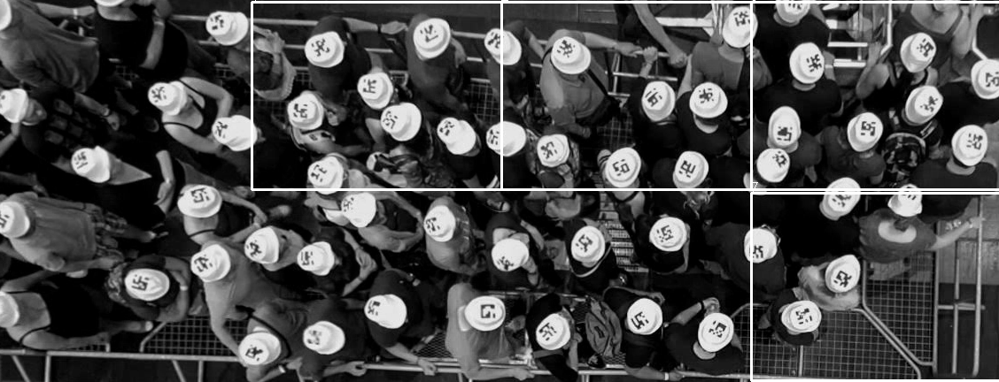

Time for show:  0.08960342407226562
Time for optical flow 0.13713502883911133
Time for MIM: 0.06146883964538574
Time for classification and annotataion:  0.07745480537414551
Time for classification and annotataion:  0.06454133987426758
Time for classification and annotataion:  0.05121326446533203
Time for classification and annotataion:  0.050077199935913086
Time for classification and annotataion:  0.061360836029052734
Time for classification and annotataion:  0.06902766227722168
Time for classification and annotataion:  0.06331229209899902
Time for classification and annotataion:  0.05236220359802246


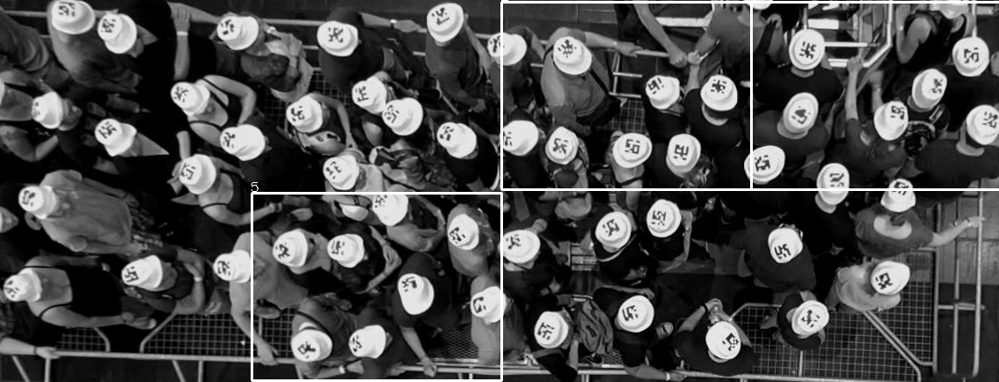

Time for show:  0.08096122741699219
Time for optical flow 0.13742470741271973
Time for MIM: 0.05770754814147949
Time for classification and annotataion:  0.08478522300720215
Time for classification and annotataion:  0.06130194664001465
Time for classification and annotataion:  0.05083036422729492
Time for classification and annotataion:  0.05022311210632324
Time for classification and annotataion:  0.06313538551330566
Time for classification and annotataion:  0.06898260116577148
Time for classification and annotataion:  0.055535316467285156
Time for classification and annotataion:  0.05019736289978027


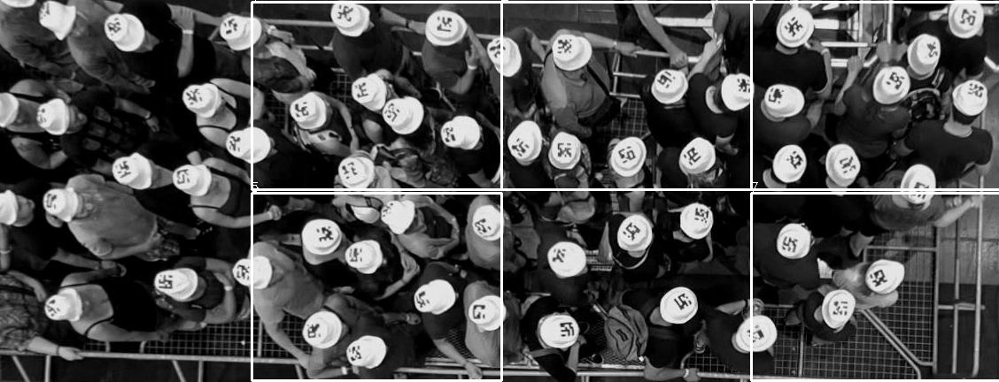

Time for show:  0.07318496704101562
Time for optical flow 0.1420145034790039
Time for MIM: 0.05714988708496094
Time for classification and annotataion:  0.07912755012512207
Time for classification and annotataion:  0.06647539138793945
Time for classification and annotataion:  0.05102658271789551
Time for classification and annotataion:  0.05784964561462402
Time for classification and annotataion:  0.06617569923400879
Time for classification and annotataion:  0.06957101821899414
Time for classification and annotataion:  0.05957365036010742
Time for classification and annotataion:  0.050781965255737305


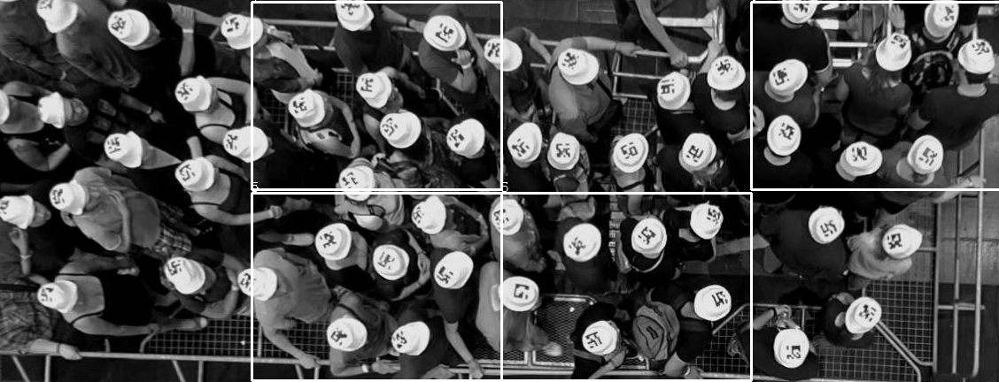

Time for show:  0.07439279556274414
Time for optical flow 0.13752365112304688
Time for MIM: 0.05621194839477539
Time for classification and annotataion:  0.07828593254089355
Time for classification and annotataion:  0.0673983097076416
Time for classification and annotataion:  0.058510541915893555
Time for classification and annotataion:  0.05297279357910156
Time for classification and annotataion:  0.06171464920043945
Time for classification and annotataion:  0.07184410095214844
Time for classification and annotataion:  0.05581545829772949
Time for classification and annotataion:  0.05020260810852051


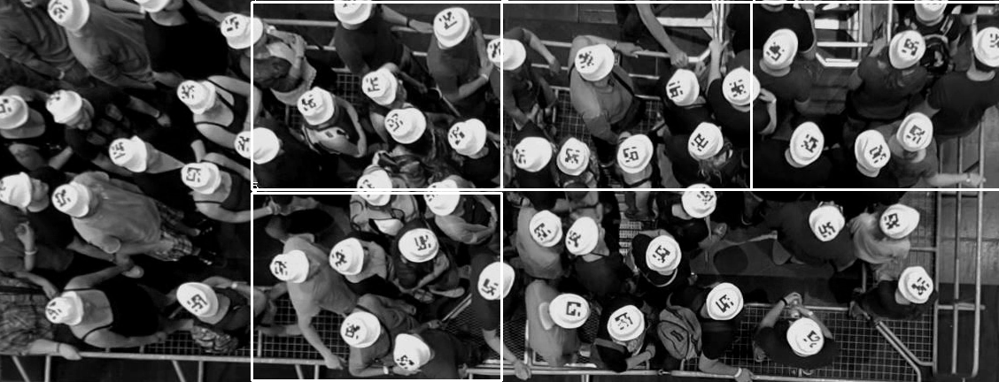

Time for show:  0.07709169387817383
Time for optical flow 0.13750791549682617
Time for MIM: 0.0572969913482666
Time for classification and annotataion:  0.08167672157287598
Time for classification and annotataion:  0.06717395782470703
Time for classification and annotataion:  0.05316638946533203
Time for classification and annotataion:  0.049387216567993164
Time for classification and annotataion:  0.07123327255249023
Time for classification and annotataion:  0.07991552352905273
Time for classification and annotataion:  0.06392884254455566
Time for classification and annotataion:  0.05048513412475586


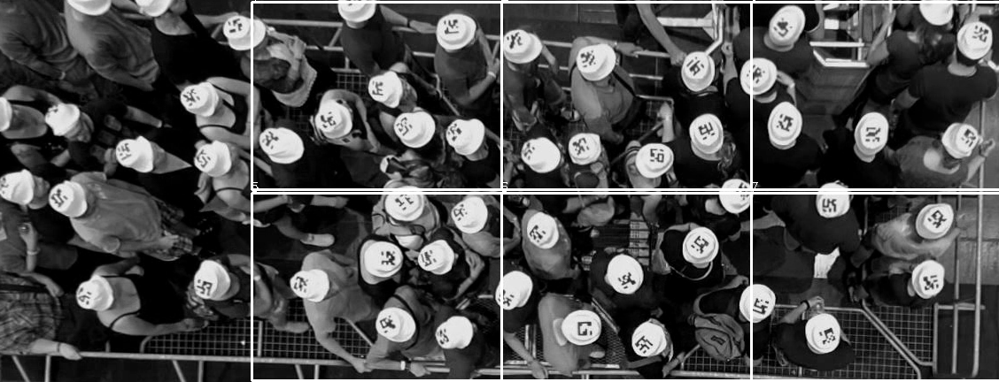

Time for show:  0.0879213809967041
Time for optical flow 0.13842487335205078
Time for MIM: 0.05616021156311035
Time for classification and annotataion:  0.0753021240234375
Time for classification and annotataion:  0.06954336166381836
Time for classification and annotataion:  0.05400347709655762
Time for classification and annotataion:  0.051253557205200195
Time for classification and annotataion:  0.07002401351928711
Time for classification and annotataion:  0.07380223274230957
Time for classification and annotataion:  0.06228017807006836
Time for classification and annotataion:  0.05055046081542969


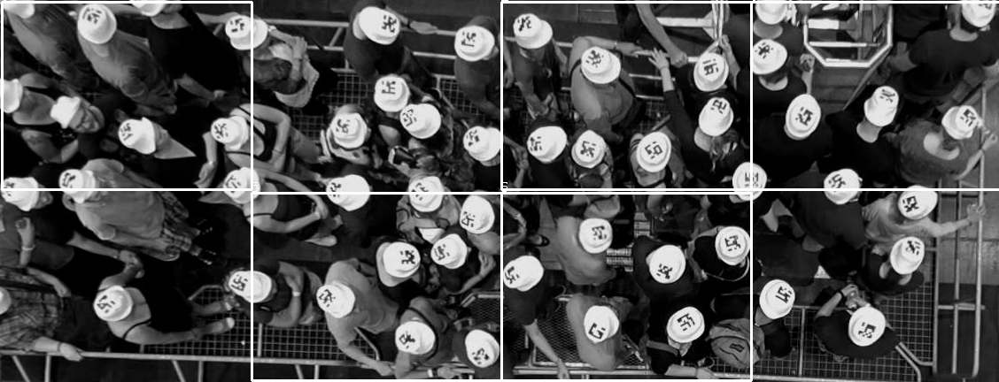

Time for show:  0.08144760131835938
Time for optical flow 0.13760089874267578
Time for MIM: 0.05724692344665527
Time for classification and annotataion:  0.07399773597717285
Time for classification and annotataion:  0.07018113136291504
Time for classification and annotataion:  0.05507230758666992
Time for classification and annotataion:  0.0514528751373291
Time for classification and annotataion:  0.06482267379760742
Time for classification and annotataion:  0.07106590270996094
Time for classification and annotataion:  0.05938267707824707
Time for classification and annotataion:  0.0505063533782959


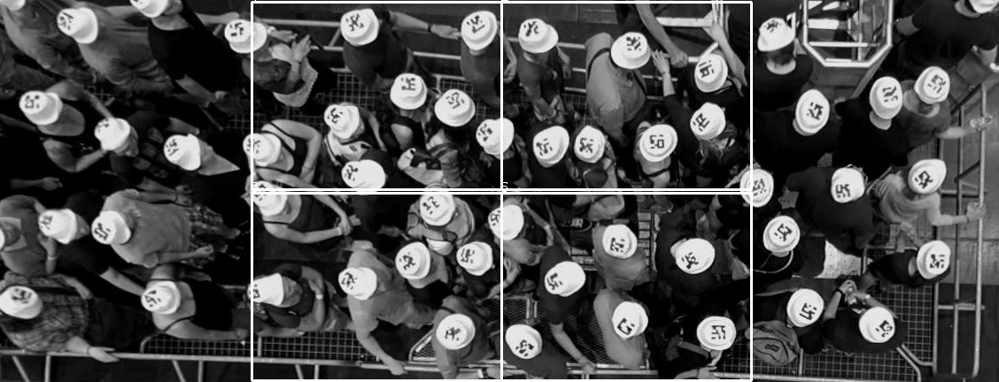

Time for show:  0.08143925666809082
Time for optical flow 0.1376054286956787
Time for MIM: 0.057348012924194336
Time for classification and annotataion:  0.08856320381164551
Time for classification and annotataion:  0.06839489936828613
Time for classification and annotataion:  0.059892892837524414
Time for classification and annotataion:  0.0505368709564209
Time for classification and annotataion:  0.07063865661621094
Time for classification and annotataion:  0.07012653350830078
Time for classification and annotataion:  0.06742286682128906
Time for classification and annotataion:  0.049902915954589844


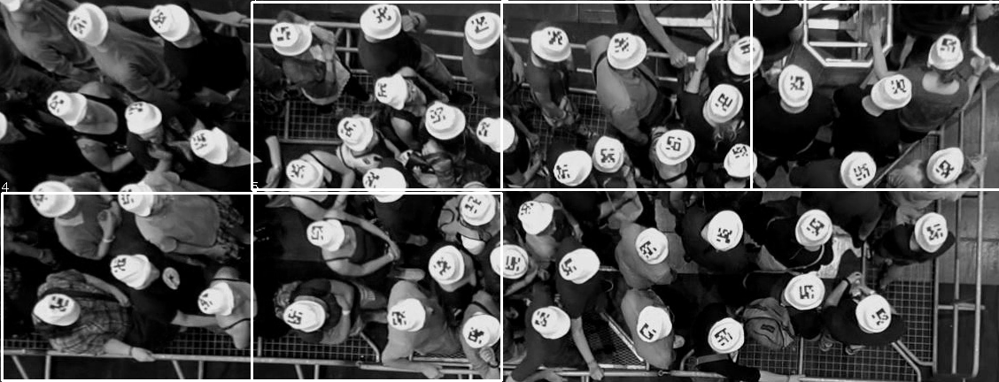

Time for show:  0.0900125503540039
Time for optical flow 0.13676738739013672
Time for MIM: 0.05627179145812988
Time for classification and annotataion:  0.07807731628417969
Time for classification and annotataion:  0.06901764869689941
Time for classification and annotataion:  0.059436798095703125
Time for classification and annotataion:  0.05058717727661133
Time for classification and annotataion:  0.06745195388793945
Time for classification and annotataion:  0.0804135799407959
Time for classification and annotataion:  0.05640530586242676
Time for classification and annotataion:  0.05121636390686035


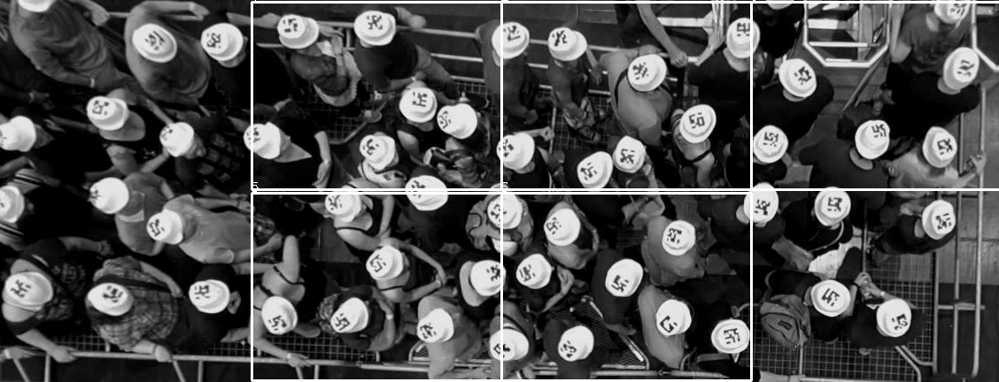

Time for show:  0.08127880096435547
Time for optical flow 0.13846468925476074
Time for MIM: 0.06014537811279297
Time for classification and annotataion:  0.08432817459106445
Time for classification and annotataion:  0.06710100173950195
Time for classification and annotataion:  0.054198503494262695
Time for classification and annotataion:  0.05767345428466797
Time for classification and annotataion:  0.07478046417236328
Time for classification and annotataion:  0.07535433769226074
Time for classification and annotataion:  0.06142377853393555
Time for classification and annotataion:  0.0511929988861084


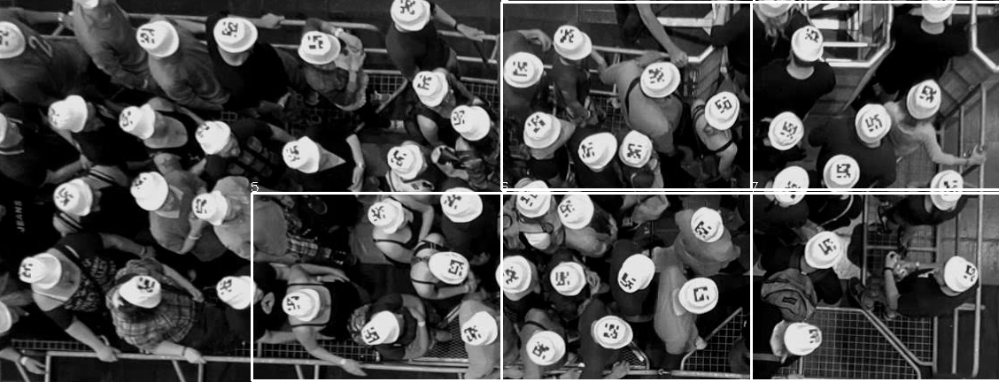

Time for show:  0.07537293434143066
Time for optical flow 0.1372966766357422
Time for MIM: 0.05930662155151367
Time for classification and annotataion:  0.07899975776672363
Time for classification and annotataion:  0.08146929740905762
Time for classification and annotataion:  0.05239129066467285
Time for classification and annotataion:  0.0503544807434082
Time for classification and annotataion:  0.07641196250915527
Time for classification and annotataion:  0.06885385513305664
Time for classification and annotataion:  0.06170535087585449
Time for classification and annotataion:  0.052434444427490234


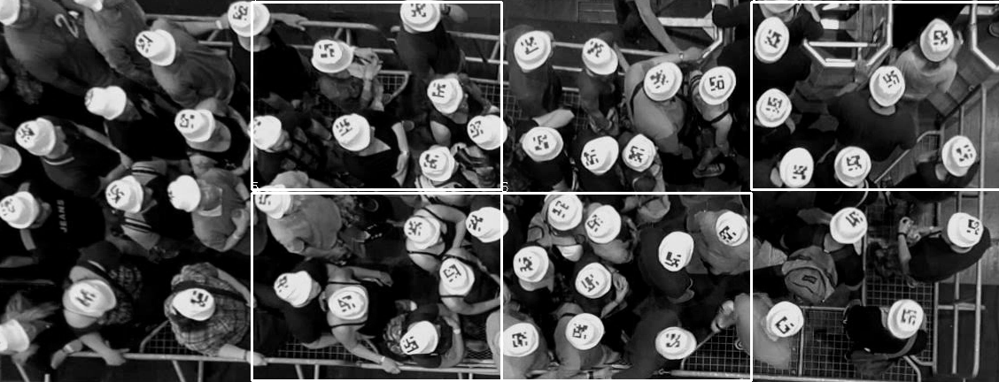

Time for show:  0.07806134223937988
Time for optical flow 0.13824129104614258
Time for MIM: 0.05835461616516113
Time for classification and annotataion:  0.0738680362701416
Time for classification and annotataion:  0.07073640823364258
Time for classification and annotataion:  0.057451486587524414
Time for classification and annotataion:  0.049849748611450195
Time for classification and annotataion:  0.0655977725982666
Time for classification and annotataion:  0.08167648315429688
Time for classification and annotataion:  0.0632028579711914
Time for classification and annotataion:  0.05756258964538574


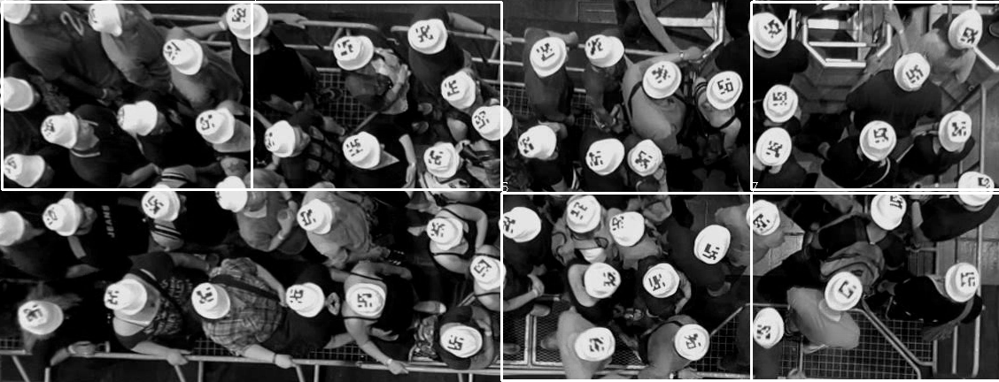

Time for show:  0.08459806442260742
Time for optical flow 0.13707375526428223
Time for MIM: 0.05634617805480957
Time for classification and annotataion:  0.08147692680358887
Time for classification and annotataion:  0.06761002540588379
Time for classification and annotataion:  0.06153750419616699
Time for classification and annotataion:  0.049663543701171875
Time for classification and annotataion:  0.06641006469726562
Time for classification and annotataion:  0.06954503059387207
Time for classification and annotataion:  0.06230521202087402
Time for classification and annotataion:  0.05049419403076172


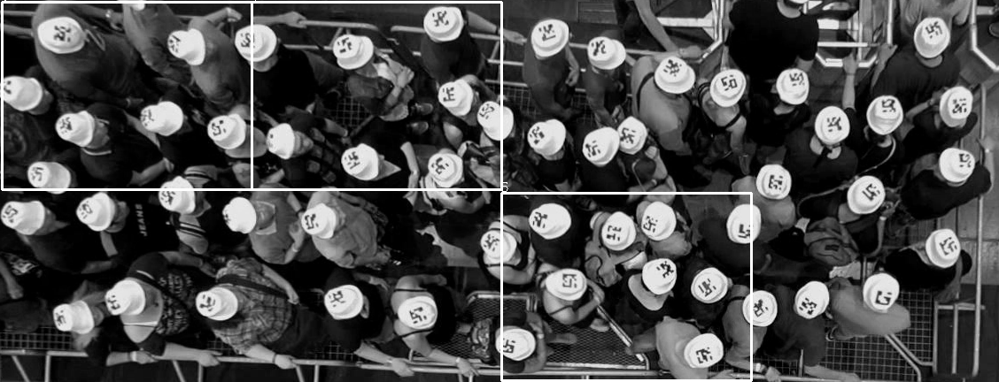

Time for show:  0.0755624771118164
Time for optical flow 0.13784337043762207
Time for MIM: 0.0589749813079834
Time for classification and annotataion:  0.07391643524169922
Time for classification and annotataion:  0.07125687599182129
Time for classification and annotataion:  0.06749176979064941
Time for classification and annotataion:  0.050447702407836914
Time for classification and annotataion:  0.06723237037658691
Time for classification and annotataion:  0.0681462287902832
Time for classification and annotataion:  0.0712580680847168
Time for classification and annotataion:  0.05468583106994629


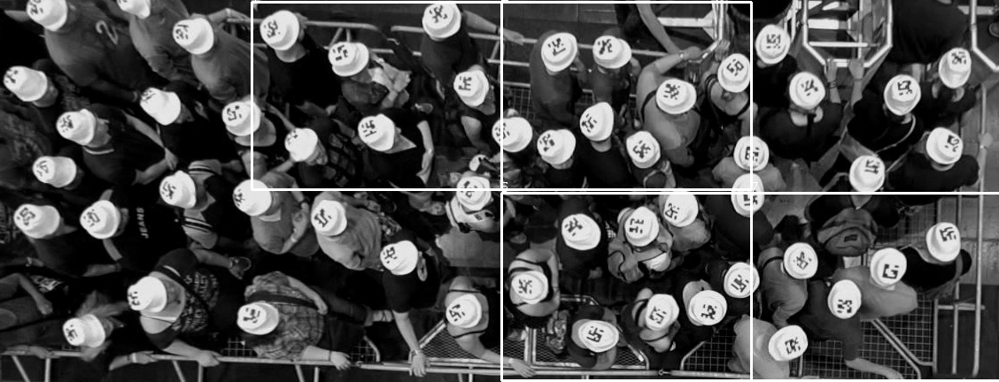

Time for show:  0.08156013488769531
Time for optical flow 0.1378326416015625
Time for MIM: 0.05976366996765137
Time for classification and annotataion:  0.07528114318847656
Time for classification and annotataion:  0.07045936584472656
Time for classification and annotataion:  0.055257320404052734
Time for classification and annotataion:  0.05006217956542969
Time for classification and annotataion:  0.07498931884765625
Time for classification and annotataion:  0.06951761245727539
Time for classification and annotataion:  0.06451177597045898
Time for classification and annotataion:  0.051166534423828125


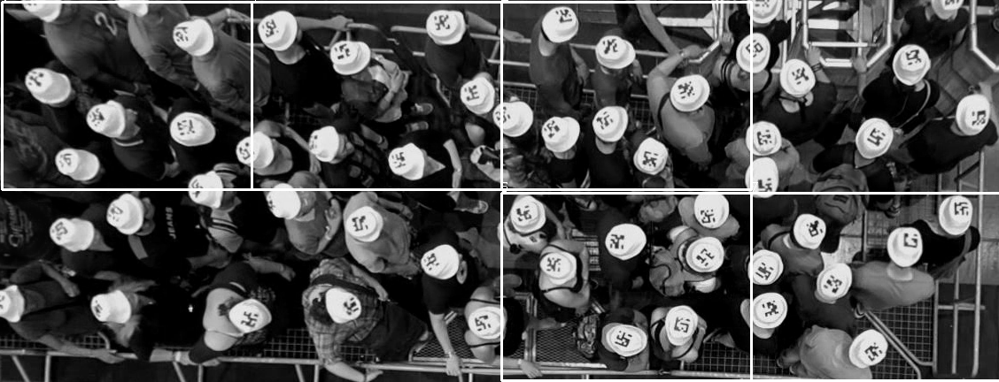

Time for show:  0.07956624031066895
Time for optical flow 0.1378178596496582
Time for MIM: 0.057787418365478516
Time for classification and annotataion:  0.07387709617614746
Time for classification and annotataion:  0.07088446617126465
Time for classification and annotataion:  0.06031370162963867
Time for classification and annotataion:  0.06039571762084961
Time for classification and annotataion:  0.07555723190307617
Time for classification and annotataion:  0.0787205696105957
Time for classification and annotataion:  0.06871676445007324
Time for classification and annotataion:  0.05472421646118164


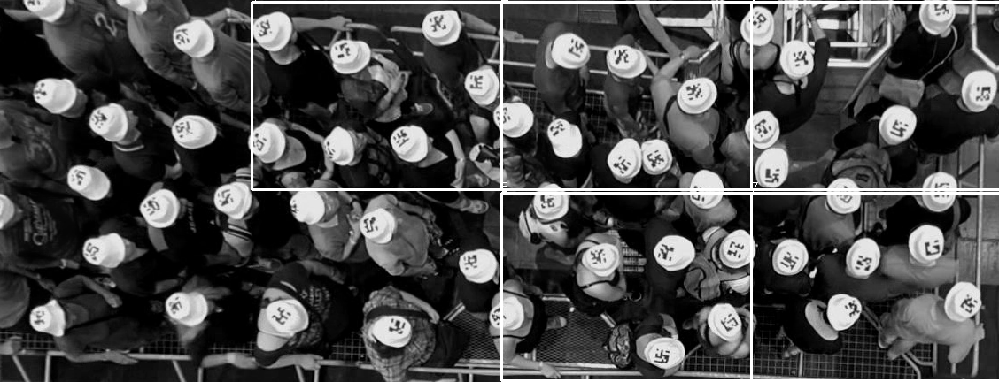

Time for show:  0.09045004844665527
Time for optical flow 0.13968563079833984
Time for MIM: 0.057924747467041016
Time for classification and annotataion:  0.08162927627563477
Time for classification and annotataion:  0.06987810134887695
Time for classification and annotataion:  0.06387066841125488
Time for classification and annotataion:  0.05412173271179199
Time for classification and annotataion:  0.08026599884033203
Time for classification and annotataion:  0.07147026062011719
Time for classification and annotataion:  0.08056879043579102
Time for classification and annotataion:  0.05281782150268555


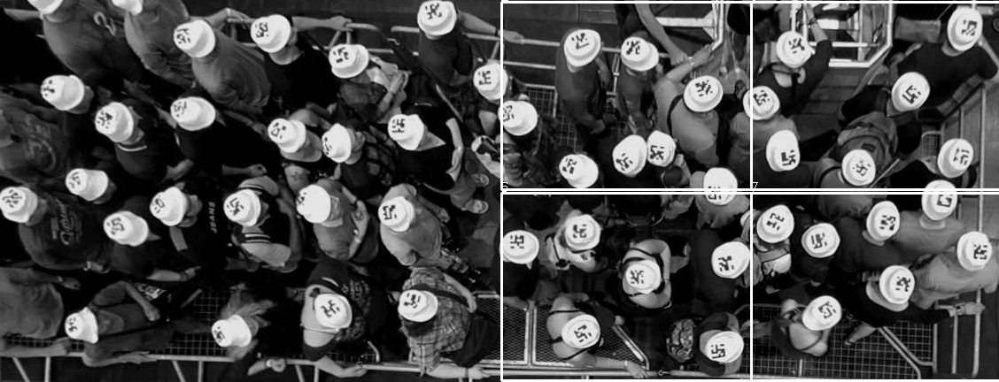

Time for show:  0.08537077903747559
Time for optical flow 0.13826918601989746
Time for MIM: 0.057053327560424805
Time for classification and annotataion:  0.08222842216491699
Time for classification and annotataion:  0.07363152503967285
Time for classification and annotataion:  0.06758522987365723
Time for classification and annotataion:  0.060896873474121094
Time for classification and annotataion:  0.07443380355834961
Time for classification and annotataion:  0.0749518871307373
Time for classification and annotataion:  0.06557655334472656
Time for classification and annotataion:  0.04890584945678711


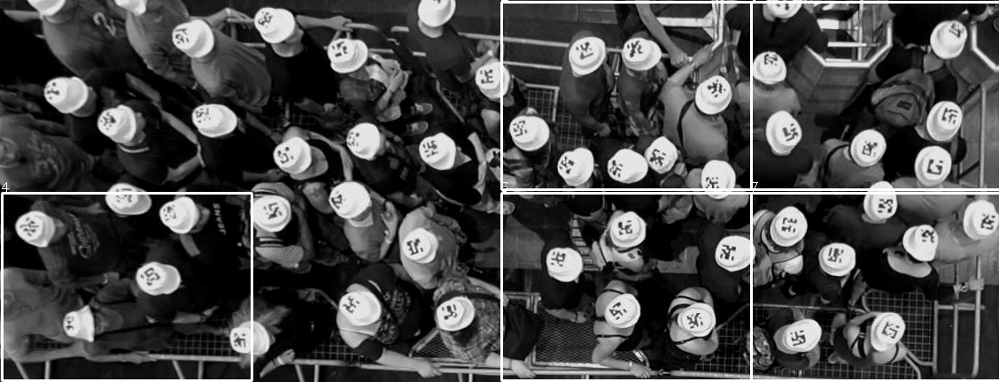

Time for show:  0.08112573623657227
Time for optical flow 0.1376934051513672
Time for MIM: 0.06317257881164551
Time for classification and annotataion:  0.07896232604980469
Time for classification and annotataion:  0.07242846488952637
Time for classification and annotataion:  0.07358980178833008
Time for classification and annotataion:  0.05092263221740723
Time for classification and annotataion:  0.07059288024902344
Time for classification and annotataion:  0.06936359405517578
Time for classification and annotataion:  0.062177181243896484
Time for classification and annotataion:  0.05104637145996094


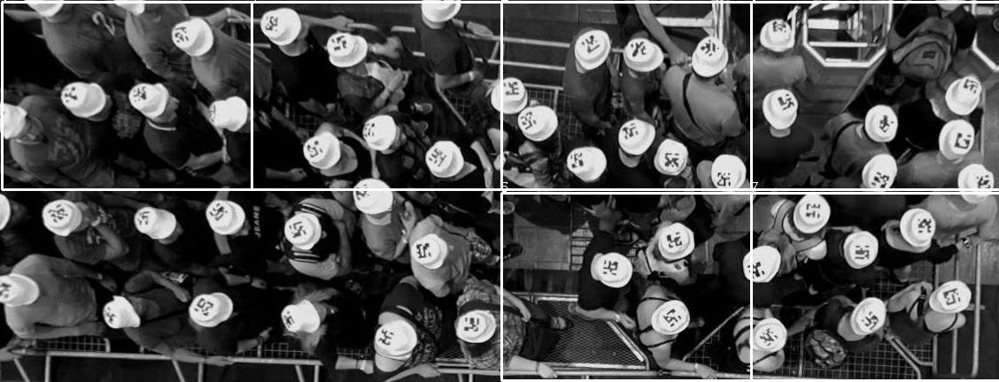

Time for show:  0.08240437507629395
Time for optical flow 0.14017367362976074
Time for MIM: 0.05697822570800781
Time for classification and annotataion:  0.07682609558105469
Time for classification and annotataion:  0.08216357231140137
Time for classification and annotataion:  0.06080508232116699
Time for classification and annotataion:  0.0495152473449707
Time for classification and annotataion:  0.0867764949798584
Time for classification and annotataion:  0.08539962768554688
Time for classification and annotataion:  0.06047797203063965
Time for classification and annotataion:  0.05308866500854492


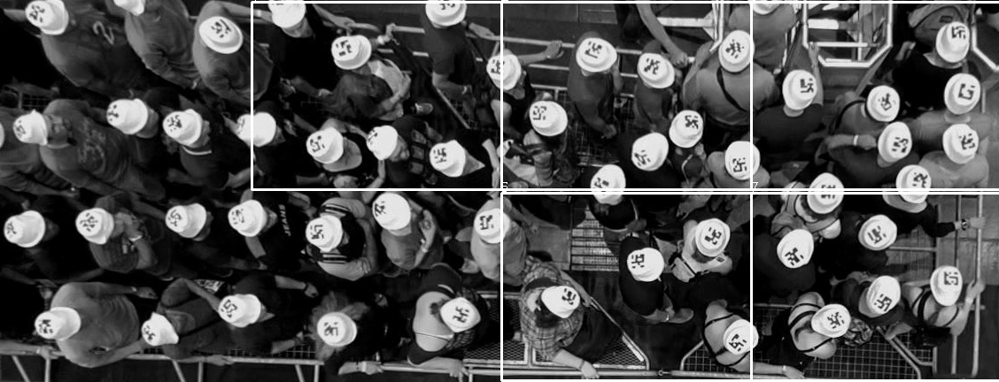

Time for show:  0.0871586799621582
Time for optical flow 0.13788127899169922
Time for MIM: 0.059786081314086914
Time for classification and annotataion:  0.08131575584411621
Time for classification and annotataion:  0.0694112777709961
Time for classification and annotataion:  0.0656130313873291
Time for classification and annotataion:  0.05745387077331543
Time for classification and annotataion:  0.07354950904846191
Time for classification and annotataion:  0.06849074363708496
Time for classification and annotataion:  0.0727386474609375
Time for classification and annotataion:  0.05032205581665039


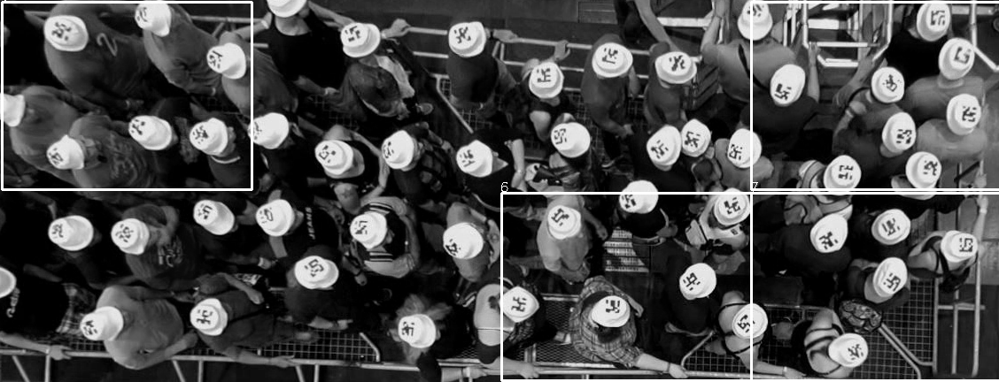

Time for show:  0.09569692611694336
Time for optical flow 0.13808655738830566
Time for MIM: 0.057581424713134766
Time for classification and annotataion:  0.07863163948059082
Time for classification and annotataion:  0.07027530670166016
Time for classification and annotataion:  0.06610846519470215
Time for classification and annotataion:  0.06138873100280762
Time for classification and annotataion:  0.08641266822814941
Time for classification and annotataion:  0.08291006088256836
Time for classification and annotataion:  0.05984926223754883
Time for classification and annotataion:  0.04968762397766113


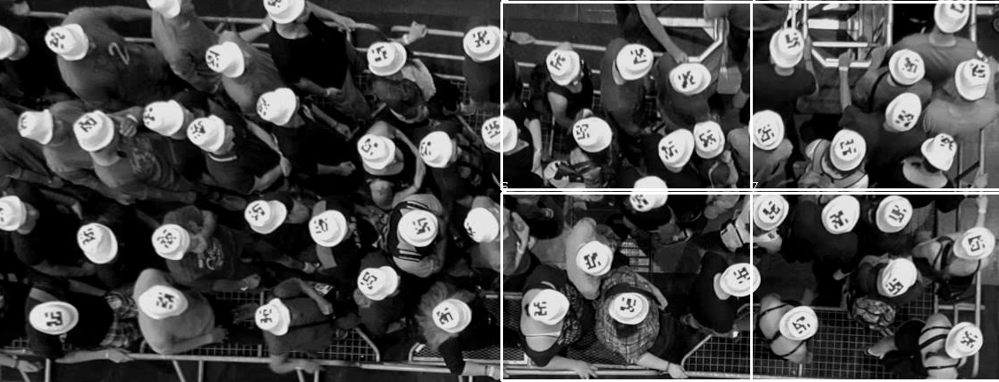

Time for show:  0.08072137832641602
Time for optical flow 0.13762140274047852
Time for MIM: 0.060888051986694336
Time for classification and annotataion:  0.08252215385437012
Time for classification and annotataion:  0.08615851402282715
Time for classification and annotataion:  0.06026649475097656
Time for classification and annotataion:  0.051286935806274414
Time for classification and annotataion:  0.07804441452026367
Time for classification and annotataion:  0.07376480102539062
Time for classification and annotataion:  0.0674440860748291
Time for classification and annotataion:  0.051229238510131836


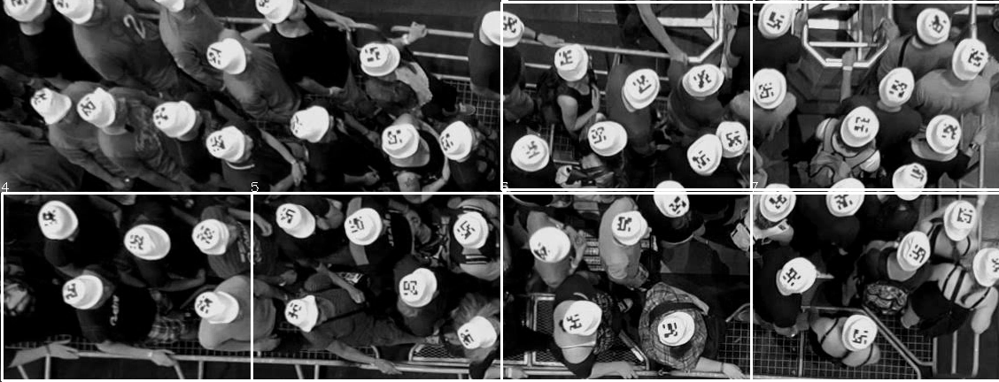

Time for show:  0.07781410217285156
Time for optical flow 0.13808751106262207
Time for MIM: 0.06011772155761719
Time for classification and annotataion:  0.07143950462341309
Time for classification and annotataion:  0.06836509704589844
Time for classification and annotataion:  0.07787919044494629
Time for classification and annotataion:  0.3001289367675781
Time for classification and annotataion:  0.0713505744934082
Time for classification and annotataion:  0.05720877647399902
Time for classification and annotataion:  0.05290818214416504
Time for classification and annotataion:  0.07973051071166992


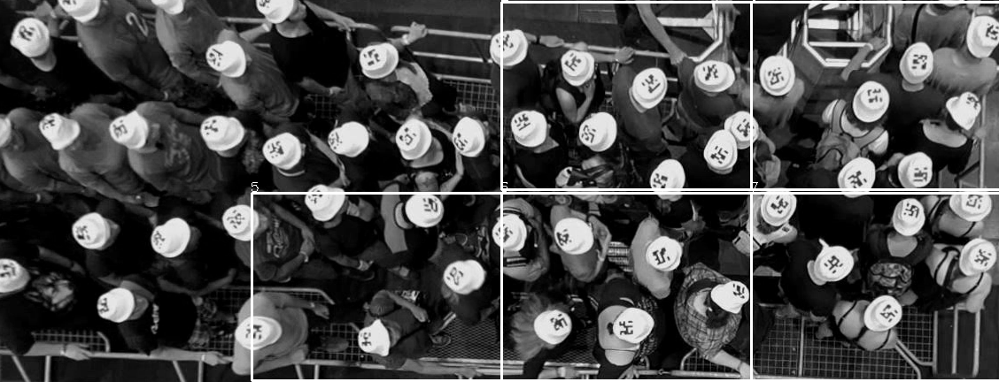

Time for show:  0.08011722564697266
Time for optical flow 0.14442229270935059
Time for MIM: 0.0565340518951416
Time for classification and annotataion:  0.07622814178466797
Time for classification and annotataion:  0.0706026554107666
Time for classification and annotataion:  0.07225465774536133
Time for classification and annotataion:  0.053830862045288086
Time for classification and annotataion:  0.0779106616973877
Time for classification and annotataion:  0.07134199142456055
Time for classification and annotataion:  0.07535743713378906
Time for classification and annotataion:  0.05237603187561035


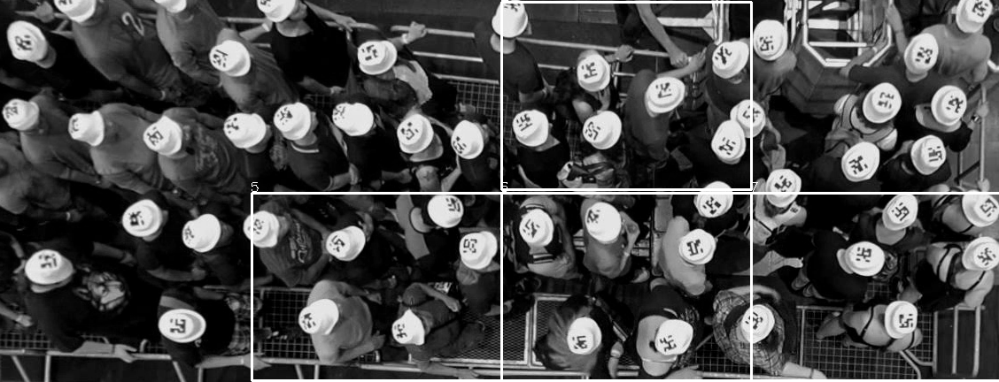

Time for show:  0.08899044990539551
Time for optical flow 0.13803720474243164
Time for MIM: 0.0590062141418457
Time for classification and annotataion:  0.08634567260742188
Time for classification and annotataion:  0.07717370986938477
Time for classification and annotataion:  0.06987714767456055
Time for classification and annotataion:  0.05475592613220215
Time for classification and annotataion:  0.09426236152648926
Time for classification and annotataion:  0.0803370475769043
Time for classification and annotataion:  0.07263970375061035
Time for classification and annotataion:  0.06514191627502441


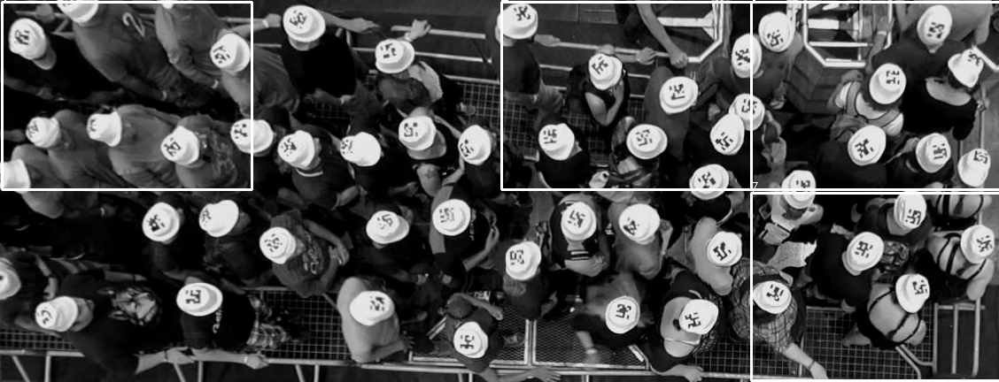

Time for show:  0.08388066291809082
Time for optical flow 0.13827943801879883
Time for MIM: 0.06502580642700195
Time for classification and annotataion:  0.08292746543884277
Time for classification and annotataion:  0.07281756401062012
Time for classification and annotataion:  0.06751060485839844
Time for classification and annotataion:  0.05013680458068848
Time for classification and annotataion:  0.07009649276733398
Time for classification and annotataion:  0.07003545761108398
Time for classification and annotataion:  0.07011890411376953
Time for classification and annotataion:  0.06575965881347656


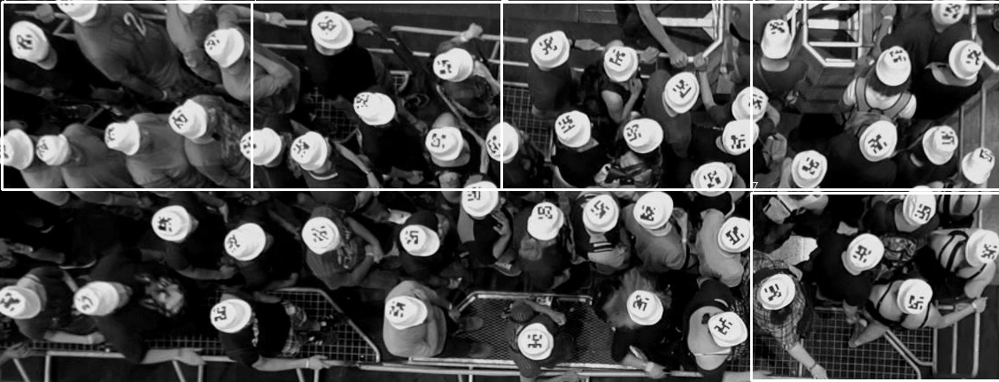

Time for show:  0.09153223037719727
Time for optical flow 0.139723539352417
Time for MIM: 0.06765222549438477
Time for classification and annotataion:  0.08662056922912598
Time for classification and annotataion:  0.07094025611877441
Time for classification and annotataion:  0.07756662368774414
Time for classification and annotataion:  0.05106306076049805
Time for classification and annotataion:  0.07737851142883301
Time for classification and annotataion:  0.0725107192993164
Time for classification and annotataion:  0.06772089004516602
Time for classification and annotataion:  0.0503389835357666


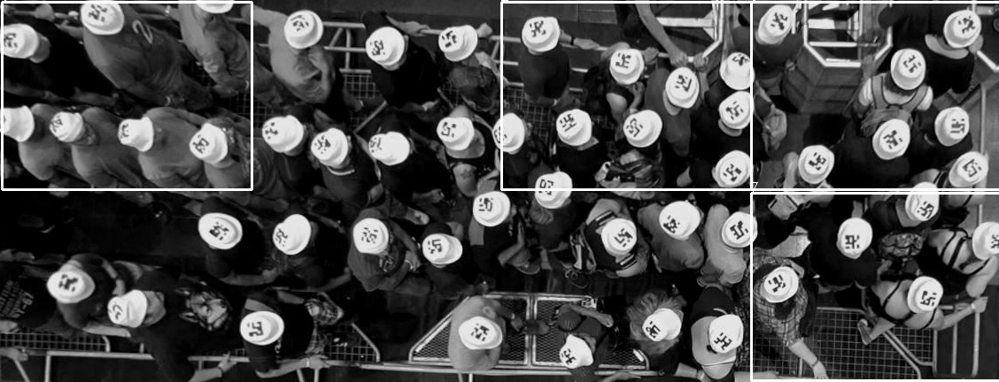

Time for show:  0.0775907039642334
Time for optical flow 0.14380598068237305
Time for MIM: 0.05693864822387695
Time for classification and annotataion:  0.07427835464477539
Time for classification and annotataion:  0.06962418556213379
Time for classification and annotataion:  0.08000588417053223
Time for classification and annotataion:  0.05667853355407715
Time for classification and annotataion:  0.0702962875366211
Time for classification and annotataion:  0.07649922370910645
Time for classification and annotataion:  0.08022022247314453
Time for classification and annotataion:  0.07052111625671387


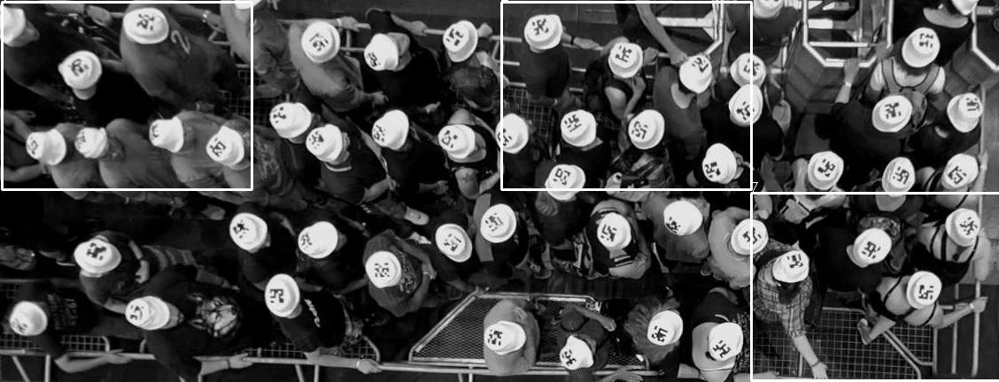

Time for show:  0.08399724960327148
Time for optical flow 0.13869190216064453
Time for MIM: 0.060155630111694336
Time for classification and annotataion:  0.07628178596496582
Time for classification and annotataion:  0.07090330123901367
Time for classification and annotataion:  0.0750734806060791
Time for classification and annotataion:  0.05944943428039551
Time for classification and annotataion:  0.09771919250488281
Time for classification and annotataion:  0.08086562156677246
Time for classification and annotataion:  0.09536409378051758
Time for classification and annotataion:  0.07769560813903809


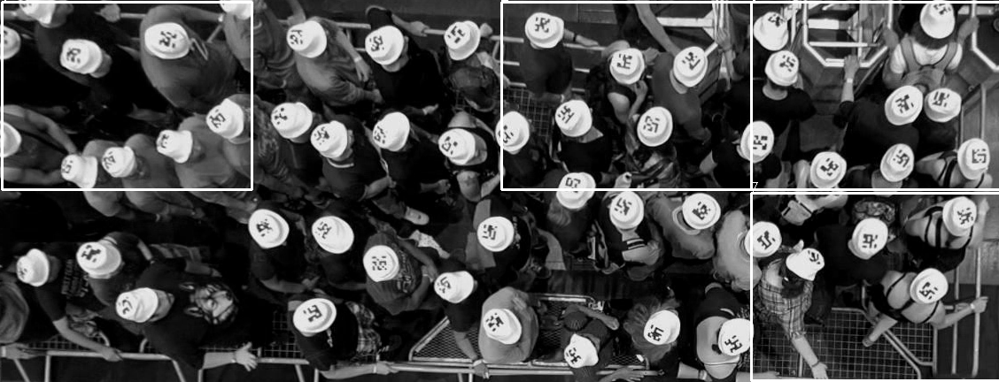

Time for show:  0.09120059013366699
Time for optical flow 0.13960671424865723
Time for MIM: 0.06185126304626465
Time for classification and annotataion:  0.07507944107055664
Time for classification and annotataion:  0.0765223503112793
Time for classification and annotataion:  0.07124042510986328
Time for classification and annotataion:  0.06881570816040039
Time for classification and annotataion:  0.07750630378723145
Time for classification and annotataion:  0.07279419898986816
Time for classification and annotataion:  0.10550093650817871
Time for classification and annotataion:  0.0715019702911377


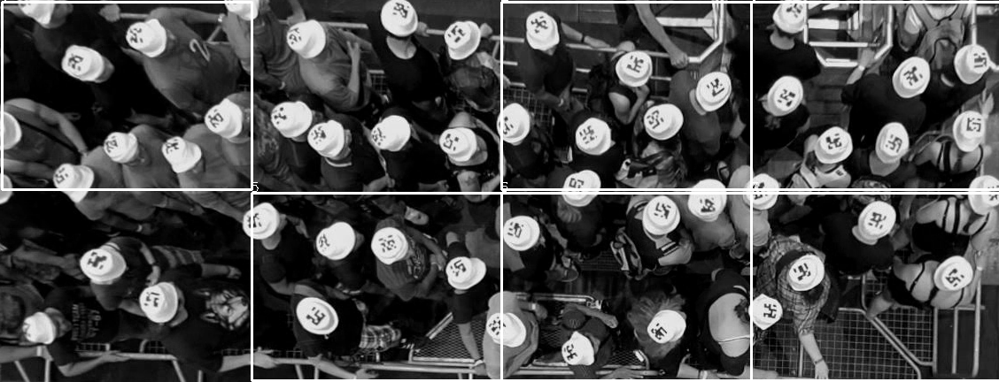

Time for show:  0.08603596687316895
Time for optical flow 0.1384727954864502
Time for MIM: 0.0585789680480957
Time for classification and annotataion:  0.0735018253326416
Time for classification and annotataion:  0.07383894920349121
Time for classification and annotataion:  0.0709848403930664
Time for classification and annotataion:  0.07662749290466309
Time for classification and annotataion:  0.07204079627990723
Time for classification and annotataion:  0.0695486068725586
Time for classification and annotataion:  0.0778648853302002
Time for classification and annotataion:  0.07215189933776855


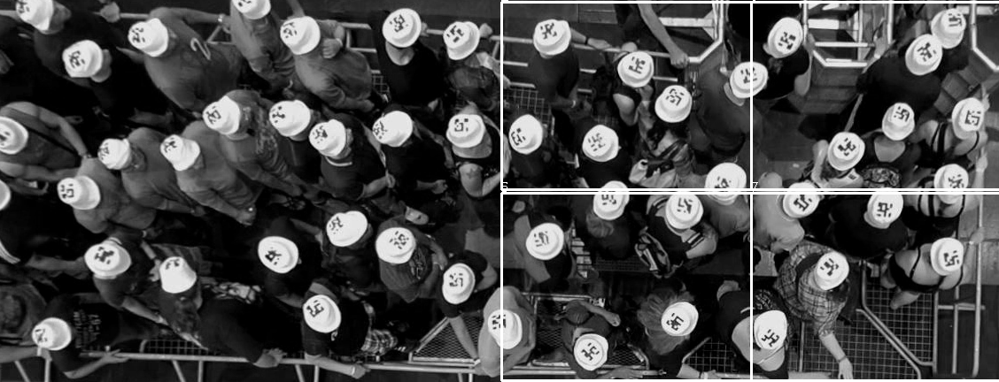

Time for show:  0.09095072746276855
Time for optical flow 0.13968706130981445
Time for MIM: 0.06737399101257324
Time for classification and annotataion:  0.09334802627563477
Time for classification and annotataion:  0.07702827453613281
Time for classification and annotataion:  0.06834578514099121
Time for classification and annotataion:  0.054615020751953125
Time for classification and annotataion:  0.07368206977844238
Time for classification and annotataion:  0.07370185852050781
Time for classification and annotataion:  0.07822823524475098
Time for classification and annotataion:  0.0716712474822998


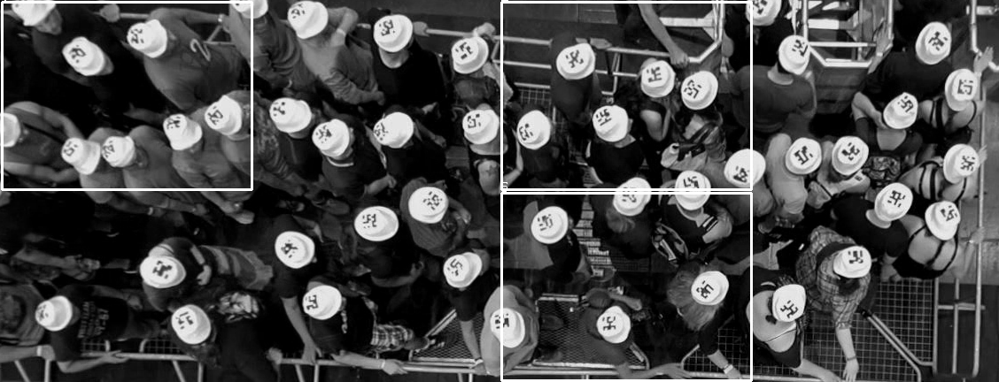

Time for show:  0.08428502082824707
Time for optical flow 0.14035773277282715
Time for MIM: 0.07788991928100586
Time for classification and annotataion:  0.09139466285705566
Time for classification and annotataion:  0.07342839241027832
Time for classification and annotataion:  0.08102202415466309
Time for classification and annotataion:  0.06672883033752441
Time for classification and annotataion:  0.07033276557922363
Time for classification and annotataion:  0.06961560249328613
Time for classification and annotataion:  0.0840919017791748
Time for classification and annotataion:  0.07759547233581543


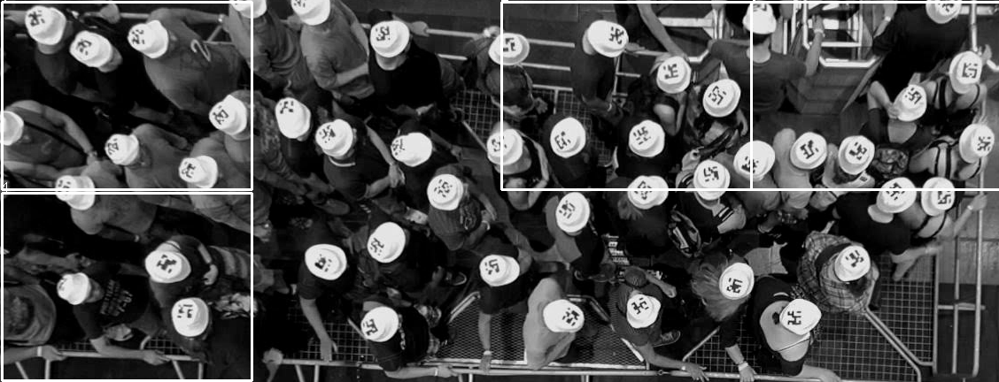

Time for show:  0.08490967750549316
Time for optical flow 0.13874149322509766
Time for MIM: 0.08620357513427734
Time for classification and annotataion:  0.07471871376037598
Time for classification and annotataion:  0.07223248481750488
Time for classification and annotataion:  0.08861207962036133
Time for classification and annotataion:  0.06668639183044434
Time for classification and annotataion:  0.08567214012145996
Time for classification and annotataion:  0.06805205345153809
Time for classification and annotataion:  0.08095145225524902
Time for classification and annotataion:  0.07581496238708496


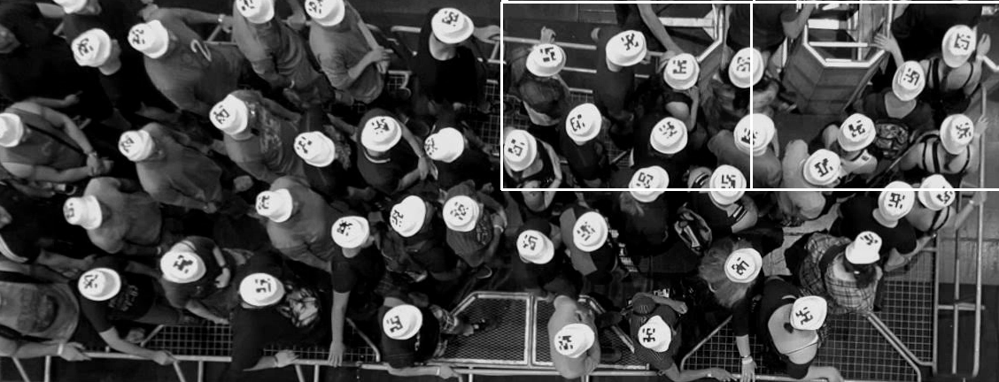

Time for show:  0.09444189071655273
Time for optical flow 0.13948869705200195
Time for MIM: 0.07836174964904785
Time for classification and annotataion:  0.07351970672607422
Time for classification and annotataion:  0.07248282432556152
Time for classification and annotataion:  0.07202959060668945
Time for classification and annotataion:  0.06511640548706055
Time for classification and annotataion:  0.081817626953125
Time for classification and annotataion:  0.0717623233795166
Time for classification and annotataion:  0.07816815376281738
Time for classification and annotataion:  0.08752751350402832


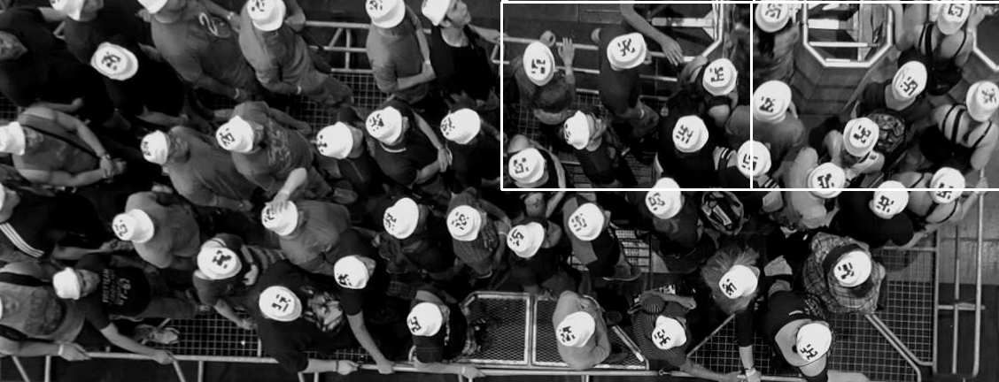

Time for show:  0.09064841270446777
Time for optical flow 0.13945770263671875
Time for MIM: 0.08025527000427246
Time for classification and annotataion:  0.07624387741088867
Time for classification and annotataion:  0.08052372932434082
Time for classification and annotataion:  0.07536506652832031
Time for classification and annotataion:  0.0752112865447998
Time for classification and annotataion:  0.07176733016967773
Time for classification and annotataion:  0.07362771034240723
Time for classification and annotataion:  0.07387447357177734
Time for classification and annotataion:  0.07076191902160645


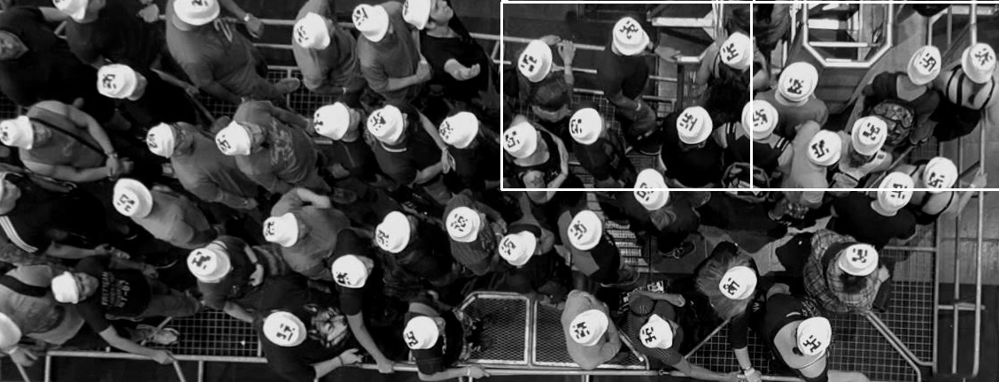

Time for show:  0.09917521476745605
total: 92.50069880485535
Total time: 92.6776933670044


In [13]:
# Do not change it
model_name=home_path+"models/raft-sintel.pth"
# The path of the input video
video_name=home_path+"videos/entrance_2.mp4"

#Number of patches
patch=[2,4]
#ROI coordinates [top-left coordinate, bottom-right coordinate]
roi=[213,110, 1338,540]
#ratio, 1: No change of the frame size
ratio_v=1
parser = ArgumentParser()
parser.add_argument("--model", help="restore checkpoint",type=str, default=model_name)
parser.add_argument("--video", type=str, default=video_name)
parser.add_argument("--save", action="store_true", help="save demo frames", default=True)
parser.add_argument("--small", action="store_true", help="use small model", default=False)
parser.add_argument("--ratio", type=int, default=ratio_v)
parser.add_argument('--roi','--list', nargs='+',type=int, help='<Required> Set flag',  default=roi)
parser.add_argument('--patch','--list1', nargs='+',type=int, help='<Required> Set flag',  default=patch)
parser.add_argument(
        "--mixed_precision", action="store_true", help="use mixed precision"
    )    

args, unknown = parser.parse_known_args()
start=time.time()
inference(args)
end=time.time()
print("Total time:", (end-start))

